<a href="https://colab.research.google.com/github/GrueneKatze/GANs_Coursera/blob/main/C2W2_VAEs.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

#Variational Autoencoder (VAE)

Check out the sister of the GAN: VAE. In this lab, you'll explore the components of a basic VAE to understand how it works.

The "AE" in VAE stands for autoencoder. As an autoencoder, the VAE has two parts: an encoder and a decoder. Instead of mapping each image to a single point in  𝑧 -space, the encoder outputs the means and covariance matrices of a multivariate normal distribution where all of the dimensions are independent. You should have had a chance to read more about multivariate normal distributions in last week's assignment, but you can think of the output of the encoder of a VAE this way: the means and standard deviations of a set of independent normal distributions, with one normal distribution (one mean and standard deviation) for each latent dimension.

*The encoding outputs a distribution in  𝑧 -space, and to generate an image you sample from the distributon and pass the  𝑧 -space sample to the decoder, which returns an image. VAE latent space visualization from Hyperspherical Variational Auto-Encoders, by Davidson et al. in UAI 2018*

##Encoder and Decoder
For your encoder and decoder, you can use similar architectures that you've seen before, with some tweaks. 

For example, for the decoder, you can use the DCGAN generator architecture. For the encoder, you can use a classifier that you used before, and instead of having it produce 1 classification output of whether something is a cat or not, for example, you can have it produce 2 different outputs, one for mean and one for standard deviation. Each of those outputs will have dimensionality  𝑧  to model the  𝑧  dimensions in the multivariate normal distributions.

In [1]:
import torch
import torch.nn as nn

class Encoder(nn.Module):
    '''
    Encoder Class
    Values:
    im_chan: the number of channels of the output image, a scalar
            MNIST is black-and-white (1 channel), so that's our default.
    hidden_dim: the inner dimension, a scalar
    '''

    def __init__(self, im_chan=1, output_chan=32, hidden_dim=16):
        super(Encoder, self).__init__()
        self.z_dim = output_chan
        self.disc = nn.Sequential(
            self.make_disc_block(im_chan, hidden_dim),
            self.make_disc_block(hidden_dim, hidden_dim * 2),
            self.make_disc_block(hidden_dim * 2, output_chan * 2, final_layer=True),
        )

    def make_disc_block(self, input_channels, output_channels, kernel_size=4, stride=2, final_layer=False):
        '''
        Function to return a sequence of operations corresponding to a encoder block of the VAE, 
        corresponding to a convolution, a batchnorm (except for in the last layer), and an activation
        Parameters:
        input_channels: how many channels the input feature representation has
        output_channels: how many channels the output feature representation should have
        kernel_size: the size of each convolutional filter, equivalent to (kernel_size, kernel_size)
        stride: the stride of the convolution
        final_layer: whether we're on the final layer (affects activation and batchnorm)
        '''        
        if not final_layer:
            return nn.Sequential(
                nn.Conv2d(input_channels, output_channels, kernel_size, stride),
                nn.BatchNorm2d(output_channels),
                nn.LeakyReLU(0.2, inplace=True),
            )
        else:
            return nn.Sequential(
                nn.Conv2d(input_channels, output_channels, kernel_size, stride),
            )

    def forward(self, image):
        '''
        Function for completing a forward pass of the Encoder: Given an image tensor, 
        returns a 1-dimension tensor representing fake/real.
        Parameters:
        image: a flattened image tensor with dimension (im_dim)
        '''
        disc_pred = self.disc(image)
        encoding = disc_pred.view(len(disc_pred), -1)
        # The stddev output is treated as the log of the variance of the normal 
        # distribution by convention and for numerical stability
        return encoding[:, :self.z_dim], encoding[:, self.z_dim:].exp()

class Decoder(nn.Module):
    '''
    Decoder Class
    Values:
    z_dim: the dimension of the noise vector, a scalar
    im_chan: the number of channels of the output image, a scalar
            MNIST is black-and-white, so that's our default
    hidden_dim: the inner dimension, a scalar
    '''
    
    def __init__(self, z_dim=32, im_chan=1, hidden_dim=64):
        super(Decoder, self).__init__()
        self.z_dim = z_dim
        self.gen = nn.Sequential(
            self.make_gen_block(z_dim, hidden_dim * 4),
            self.make_gen_block(hidden_dim * 4, hidden_dim * 2, kernel_size=4, stride=1),
            self.make_gen_block(hidden_dim * 2, hidden_dim),
            self.make_gen_block(hidden_dim, im_chan, kernel_size=4, final_layer=True),
        )

    def make_gen_block(self, input_channels, output_channels, kernel_size=3, stride=2, final_layer=False):
        '''
        Function to return a sequence of operations corresponding to a Decoder block of the VAE, 
        corresponding to a transposed convolution, a batchnorm (except for in the last layer), and an activation
        Parameters:
        input_channels: how many channels the input feature representation has
        output_channels: how many channels the output feature representation should have
        kernel_size: the size of each convolutional filter, equivalent to (kernel_size, kernel_size)
        stride: the stride of the convolution
        final_layer: whether we're on the final layer (affects activation and batchnorm)
        '''
        if not final_layer:
            return nn.Sequential(
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride),
                nn.BatchNorm2d(output_channels),
                nn.ReLU(inplace=True),
            )
        else:
            return nn.Sequential(
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride),
                nn.Sigmoid(),
            )

    def forward(self, noise):
        '''
        Function for completing a forward pass of the Decoder: Given a noise vector, 
        returns a generated image.
        Parameters:
        noise: a noise tensor with dimensions (batch_size, z_dim)
        '''
        x = noise.view(len(noise), self.z_dim, 1, 1)
        return self.gen(x)

##VAE
You can define the VAE using the encoder and decoder as follows. In the forward pass, the VAE samples from the encoder's output distribution before passing a value to the decoder. A common mistake is to pass the mean to the decoder --- this leads to blurrier images and is not the way in which VAEs are designed to be used. So, the steps you'll take are:

1. Real image input to encoder

2. Encoder outputs mean and standard deviation
3. Sample from distribution with the outputed mean and standard deviation
4. Take sampled value (vector/latent) as the input to the decoder
5. Get fake sample
6. Use reconstruction loss between the fake output of the decoder and the original real input to the encoder (more about this later - keep reading!)
7. Backpropagate through

##Quick Note on Implementation Notation ("Reparameterization Trick")
Most machine learning frameworks will not backpropagate through a random sample (Step 3-4 above work in the forward pass, but its gradient is not readily implemented for the backward pass using the usual notation). 

In PyTorch, you can do this by sampling using the rsample method, such as in Normal(mean, stddev).rsample(). This is equivalent to torch.randn(z_dim) * stddev + mean, but do not use torch.normal(mean, stddev), as the optimizer will not backpropagate through the expectation of that sample. This is also known as the reparameterization trick, since you're moving the parameters of the random sample outside of the the function to explicitly highlight that the gradient should be calculated through these parameters.

In [2]:
from torch.distributions.normal import Normal

class VAE(nn.Module):
    '''
    VAE Class
    Values:
    z_dim: the dimension of the noise vector, a scalar
    im_chan: the number of channels of the output image, a scalar
            MNIST is black-and-white, so that's our default
    hidden_dim: the inner dimension, a scalar
    '''
    
    def __init__(self, z_dim=32, im_chan=1, hidden_dim=64):
        super(VAE, self).__init__()
        self.z_dim = z_dim
        self.encode = Encoder(im_chan, z_dim)
        self.decode = Decoder(z_dim, im_chan)

    def forward(self, images):
        '''
        Function for completing a forward pass of the Decoder: Given a noise vector, 
        returns a generated image.
        Parameters:
        images: an image tensor with dimensions (batch_size, im_chan, im_height, im_width)
        Returns:
        decoding: the autoencoded image
        q_dist: the z-distribution of the encoding
        '''
        q_mean, q_stddev = self.encode(images)
        q_dist = Normal(q_mean, q_stddev)
        z_sample = q_dist.rsample() # Sample once from each distribution, using the `rsample` notation
        decoding = self.decode(z_sample)
        return decoding, q_dist

##Evidence Lower Bound (ELBO)
When training a VAE, you're trying to maximize the likelihood of the real images. What this means is that you'd like the learned probability distribution to think it's likely that a real image (and the features in that real image) occurs -- as opposed to, say, random noise or weird-looking things. And you want to maximize the likelihood of the real stuff occurring and appropriately associate it with a point in the latent space distribution prior  𝑝(𝑧)  (more on this below), which is where your learned latent noise vectors will live. However, finding this likelihood explicitly is mathematically intractable. So, instead, you can get a good lower bound on the likelihood, meaning you can figure out what the worst-case scenario of the likelihood is (its lower bound which is mathematically tractable) and try to maximize that instead. Because if you maximize its lower bound, or worst-case, then you probably are making the likelihood better too. And this neat technique is known as maximizing the Evidence Lower Bound (ELBO).

Some notation before jumping into explaining ELBO: First, the prior latent space distribution  𝑝(𝑧)  is the prior probability you have on the latent space  𝑧 . This represents the likelihood of a given latent point in the latent space, and you know what this actually is because you set it in the beginning as a multivariate normal distribution. Additionally,  𝑞(𝑧)  refers to the posterior probability, or the distribution of the encoded images. Keep in mind that when each image is passed through the encoder, its encoding is a probability distribution.

Knowing that notation, here's the mathematical notation for the ELBO of a VAE, which is the lower bound you want to maximize:  𝔼(log𝑝(𝑥|𝑧))+𝔼(log𝑝(𝑧)𝑞(𝑧)) , which is equivalent to  𝔼(log𝑝(𝑥|𝑧))−DKL(𝑞(𝑧|𝑥)‖𝑝(𝑧)) 
ELBO can be broken down into two parts: the reconstruction loss  𝔼(log𝑝(𝑥|𝑧))  and the KL divergence term  DKL(𝑞(𝑧|𝑥)‖𝑝(𝑧)) . You'll explore each of these two terms in the next code and text sections.

###Reconstruction Loss
Reconstruction loss refers to the distance between the real input image (that you put into the encoder) and the generated image (that comes out of the decoder). Explicitly, the reconstruction loss term is 𝔼(log𝑝(𝑥|𝑧)), the log probability of the true image given the latent value.

For MNIST, you can treat each grayscale prediction as a binary random variable (also known as a Bernoulli distribution) with the value between 0 and 1 of a pixel corresponding to the output brightness, so you can use the binary cross entropy loss between the real input image and the generated image in order to represent the reconstruction loss term.

In general, different assumptions about the "distribution" of the pixel brightnesses in an image will lead to different loss functions. For example, if you assume that the brightnesses of the pixels actually follow a normal distribution instead of a binary random (Bernoulli) distribution, this corresponds to a mean squared error (MSE) reconstruction loss.

Why the mean squared error? Well, as a point moves away from the center, 𝜇, of a normal distribution, its negative log likelihood increases quadratically. You can also write this as NLL(𝑥)∝(𝑥−𝜇)2 for 𝑥∼(𝜇,𝜎). As a result, assuming the pixel brightnesses are normally distributed implies an MSE reconstruction loss.

In [ ]:
#https://www.tensorflow.org/tutorials/images/transfer_learning
!pip install -q tf-nightly

     |████████████████████████████████| 399.4MB 42kB/s 
     |████████████████████████████████| 4.0MB 52.1MB/s 
     |████████████████████████████████| 4.0MB 53.5MB/s 
     |████████████████████████████████| 12.2MB 49.7MB/s 
     |████████████████████████████████| 471kB 56.6MB/s 
ERROR: tensorflow 2.4.0 has requirement grpcio~=1.32.0, but you'll have grpcio 1.34.0 which is incompatible.
ERROR: tensorflow 2.4.0 has requirement h5py~=2.10.0, but you'll have h5py 3.1.0 which is incompatible.


In [ ]:
import os
import tensorflow as tf

from tensorflow.keras.preprocessing import image_dataset_from_directory

In [ ]:
!curl -O http://download.tensorflow.org/models/image/imagenet/inception-v3-2016-03-01.tar.gz

  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100  380M  100  380M    0     0  86.7M      0  0:00:04  0:00:04 --:--:-- 91.2M


**Loading WGAN script for MNIST**

In [ ]:
class Generator(nn.Module):
    '''
    Generator Class
    Values:
        z_dim: the dimension of the noise vector, a scalar
        im_chan: the number of channels in the images, fitted for the dataset used, a scalar
              (MNIST is black-and-white, so 1 channel is your default)
        hidden_dim: the inner dimension, a scalar
    '''
    def __init__(self, z_dim=10, im_chan=1, hidden_dim=64):
        super(Generator, self).__init__()
        self.z_dim = z_dim
        # Build the neural network
        self.gen = nn.Sequential(
            self.make_gen_block(z_dim, hidden_dim * 4),
            self.make_gen_block(hidden_dim * 4, hidden_dim * 2, kernel_size=4, stride=1),
            self.make_gen_block(hidden_dim * 2, hidden_dim),
            self.make_gen_block(hidden_dim, im_chan, kernel_size=4, final_layer=True),
        )

    def make_gen_block(self, input_channels, output_channels, kernel_size=3, stride=2, final_layer=False):
        '''
        Function to return a sequence of operations corresponding to a generator block of DCGAN;
        a transposed convolution, a batchnorm (except in the final layer), and an activation.
        Parameters:
            input_channels: how many channels the input feature representation has
            output_channels: how many channels the output feature representation should have
            kernel_size: the size of each convolutional filter, equivalent to (kernel_size, kernel_size)
            stride: the stride of the convolution
            final_layer: a boolean, true if it is the final layer and false otherwise 
                      (affects activation and batchnorm)
        '''
        if not final_layer:
            return nn.Sequential(
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride),
                nn.BatchNorm2d(output_channels),
                nn.ReLU(inplace=True),
            )
        else:
            return nn.Sequential(
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride),
                nn.Tanh(),
            )

    def forward(self, noise):
        '''
        Function for completing a forward pass of the generator: Given a noise tensor,
        returns generated images.
        Parameters:
            noise: a noise tensor with dimensions (n_samples, z_dim)
        '''
        x = noise.view(len(noise), self.z_dim, 1, 1)
        return self.gen(x)

def get_noise(n_samples, z_dim, device='cpu'):
    '''
    Function for creating noise vectors: Given the dimensions (n_samples, z_dim)
    creates a tensor of that shape filled with random numbers from the normal distribution.
    Parameters:
      n_samples: the number of samples to generate, a scalar
      z_dim: the dimension of the noise vector, a scalar
      device: the device type
    '''
    return torch.randn(n_samples, z_dim, device=device)

In [ ]:
class Critic(nn.Module):
    '''
    Critic Class
    Values:
        im_chan: the number of channels in the images, fitted for the dataset used, a scalar
              (MNIST is black-and-white, so 1 channel is your default)
        hidden_dim: the inner dimension, a scalar
    '''
    def __init__(self, im_chan=1, hidden_dim=64):
        super(Critic, self).__init__()
        self.crit = nn.Sequential(
            self.make_crit_block(im_chan, hidden_dim),
            self.make_crit_block(hidden_dim, hidden_dim * 2),
            self.make_crit_block(hidden_dim * 2, 1, final_layer=True),
        )

    def make_crit_block(self, input_channels, output_channels, kernel_size=4, stride=2, final_layer=False):
        '''
        Function to return a sequence of operations corresponding to a critic block of DCGAN;
        a convolution, a batchnorm (except in the final layer), and an activation (except in the final layer).
        Parameters:
            input_channels: how many channels the input feature representation has
            output_channels: how many channels the output feature representation should have
            kernel_size: the size of each convolutional filter, equivalent to (kernel_size, kernel_size)
            stride: the stride of the convolution
            final_layer: a boolean, true if it is the final layer and false otherwise 
                      (affects activation and batchnorm)
        '''
        if not final_layer:
            return nn.Sequential(
                nn.Conv2d(input_channels, output_channels, kernel_size, stride),
                nn.BatchNorm2d(output_channels),
                nn.LeakyReLU(0.2, inplace=True),
            )
        else:
            return nn.Sequential(
                nn.Conv2d(input_channels, output_channels, kernel_size, stride),
            )

    def forward(self, image):
        '''
        Function for completing a forward pass of the critic: Given an image tensor, 
        returns a 1-dimension tensor representing fake/real.
        Parameters:
            image: a flattened image tensor with dimension (im_chan)
        '''
        crit_pred = self.crit(image)
        return crit_pred.view(len(crit_pred), -1)

In [ ]:
n_epochs = 100
z_dim = 64
display_step = 50
batch_size = 128
lr = 0.0002
beta_1 = 0.5
beta_2 = 0.999
c_lambda = 10
crit_repeats = 5
device = 'cuda'

transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize((0.5,), (0.5,)),
])

dataloader = DataLoader(
    MNIST('.', download=True, transform=transform),
    batch_size=batch_size,
    shuffle=True)

Extracting ./MNIST/raw/train-images-idx3-ubyte.gz to ./MNIST/raw



Extracting ./MNIST/raw/train-labels-idx1-ubyte.gz to ./MNIST/raw


Extracting ./MNIST/raw/t10k-images-idx3-ubyte.gz to ./MNIST/raw


Extracting ./MNIST/raw/t10k-labels-idx1-ubyte.gz to ./MNIST/raw
Processing...
Done!


/usr/local/lib/python3.6/dist-packages/torchvision/datasets/mnist.py:480: UserWarning: The given NumPy array is not writeable, and PyTorch does not support non-writeable tensors. This means you can write to the underlying (supposedly non-writeable) NumPy array using the tensor. You may want to copy the array to protect its data or make it writeable before converting it to a tensor. This type of warning will be suppressed for the rest of this program. (Triggered internally at  /pytorch/torch/csrc/utils/tensor_numpy.cpp:141.)
  return torch.from_numpy(parsed.astype(m[2], copy=False)).view(*s)


In [ ]:
gen = Generator(z_dim).to(device)
gen_opt = torch.optim.Adam(gen.parameters(), lr=lr, betas=(beta_1, beta_2))
crit = Critic().to(device) 
crit_opt = torch.optim.Adam(crit.parameters(), lr=lr, betas=(beta_1, beta_2))

def weights_init(m):
    if isinstance(m, nn.Conv2d) or isinstance(m, nn.ConvTranspose2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
    if isinstance(m, nn.BatchNorm2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
        torch.nn.init.constant_(m.bias, 0)
gen = gen.apply(weights_init)
crit = crit.apply(weights_init)

In [ ]:
def get_gradient(crit, real, fake, epsilon):
    '''
    Return the gradient of the critic's scores with respect to mixes of real and fake images.
    Parameters:
        crit: the critic model
        real: a batch of real images
        fake: a batch of fake images
        epsilon: a vector of the uniformly random proportions of real/fake per mixed image
    Returns:
        gradient: the gradient of the critic's scores, with respect to the mixed image
    '''
    # Mix the images together
    mixed_images = real * epsilon + fake * (1 - epsilon)

    # Calculate the critic's scores on the mixed images
    mixed_scores = crit(mixed_images)
    
    # Take the gradient of the scores with respect to the images
    gradient = torch.autograd.grad(
        # Note: You need to take the gradient of outputs with respect to inputs.
        # This documentation may be useful, but it should not be necessary:
        # https://pytorch.org/docs/stable/autograd.html#torch.autograd.grad
        #### START CODE HERE ####
        outputs = mixed_scores, inputs = mixed_images,grad_outputs=torch.ones_like(mixed_scores), 
        create_graph=True, retain_graph=True,)[0]
    return gradient

In [ ]:
def test_get_gradient(image_shape):
    real = torch.randn(*image_shape, device=device) + 1
    fake = torch.randn(*image_shape, device=device) - 1
    epsilon_shape = [1 for _ in image_shape]
    epsilon_shape[0] = image_shape[0]
    epsilon = torch.rand(epsilon_shape, device=device).requires_grad_()
    gradient = get_gradient(crit, real, fake, epsilon)
    assert tuple(gradient.shape) == image_shape
    assert gradient.max() > 0
    assert gradient.min() < 0
    return gradient

gradient = test_get_gradient((256, 1, 28, 28))
print("Success!")

Success!


In [ ]:
def gradient_penalty(gradient):
    '''
    Return the gradient penalty, given a gradient.
    Given a batch of image gradients, you calculate the magnitude of each image's gradient
    and penalize the mean quadratic distance of each magnitude to 1.
    Parameters:
        gradient: the gradient of the critic's scores, with respect to the mixed image
    Returns:
        penalty: the gradient penalty
    '''
    # Flatten the gradients so that each row captures one image
    gradient = gradient.view(len(gradient), -1)

    # Calculate the magnitude of every row
    gradient_norm = gradient.norm(2, dim=1)
    
    # Penalize the mean squared distance of the gradient norms from 1
    #### START CODE HERE ####
    penalty = torch.mean(torch.square(gradient_norm - torch.ones_like(gradient_norm)))
    #### END CODE HERE ####
    return penalty

In [ ]:
def test_gradient_penalty(image_shape):
    bad_gradient = torch.zeros(*image_shape)
    bad_gradient_penalty = gradient_penalty(bad_gradient)
    assert torch.isclose(bad_gradient_penalty, torch.tensor(1.))

    image_size = torch.prod(torch.Tensor(image_shape[1:]))
    good_gradient = torch.ones(*image_shape) / torch.sqrt(image_size)
    good_gradient_penalty = gradient_penalty(good_gradient)
    assert torch.isclose(good_gradient_penalty, torch.tensor(0.))

    random_gradient = test_get_gradient(image_shape)
    random_gradient_penalty = gradient_penalty(random_gradient)
    assert torch.abs(random_gradient_penalty - 1) < 0.1

test_gradient_penalty((256, 1, 28, 28))
print("Success!")

Success!


In [ ]:
def get_gen_loss(crit_fake_pred):
    '''
    Return the loss of a generator given the critic's scores of the generator's fake images.
    Parameters:
        crit_fake_pred: the critic's scores of the fake images
    Returns:
        gen_loss: a scalar loss value for the current batch of the generator
    '''
    #### START CODE HERE ####
    gen_loss = - torch.mean(crit_fake_pred)
    return gen_loss

In [ ]:
assert torch.isclose(
    get_gen_loss(torch.tensor(1.)), torch.tensor(-1.0)
)

assert torch.isclose(
    get_gen_loss(torch.rand(10000)), torch.tensor(-0.5), 0.05
)

print("Success!")

Success!


In [ ]:
def get_crit_loss(crit_fake_pred, crit_real_pred, gp, c_lambda):
    '''
    Return the loss of a critic given the critic's scores for fake and real images,
    the gradient penalty, and gradient penalty weight.
    Parameters:
        crit_fake_pred: the critic's scores of the fake images
        crit_real_pred: the critic's scores of the real images
        gp: the unweighted gradient penalty
        c_lambda: the current weight of the gradient penalty 
    Returns:
        crit_loss: a scalar for the critic's loss, accounting for the relevant factors
    '''
    #### START CODE HERE ####
    crit_loss = torch.mean(crit_fake_pred)-torch.mean(crit_real_pred) + gp*c_lambda
    return crit_loss

In [ ]:
assert torch.isclose(
    get_crit_loss(torch.tensor(1.), torch.tensor(2.), torch.tensor(3.), 0.1),
    torch.tensor(-0.7)
)
assert torch.isclose(
    get_crit_loss(torch.tensor(20.), torch.tensor(-20.), torch.tensor(2.), 10),
    torch.tensor(60.)
)

print("Success!")

Success!


Step 50: Generator loss: -0.17372641428839417, critic loss: 2.3561635839343067


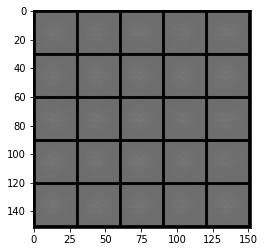

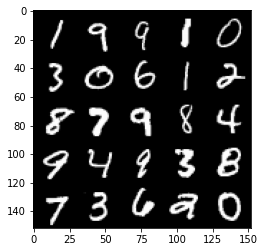

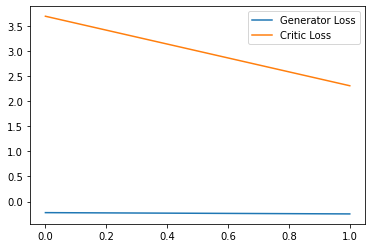

Step 100: Generator loss: 0.7390268041193485, critic loss: -1.019740001022816


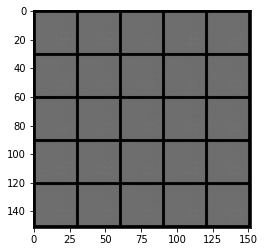

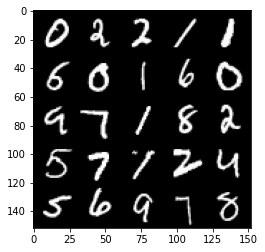

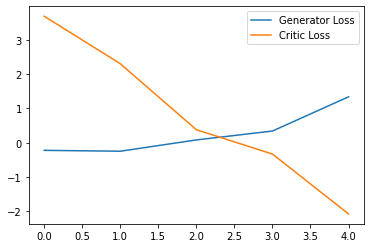

Step 150: Generator loss: 3.079772710800171, critic loss: -7.8960534267425535


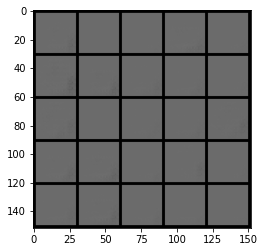

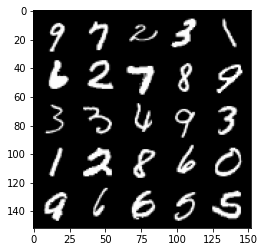

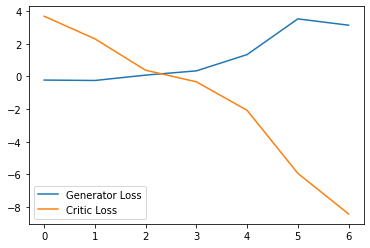

Step 200: Generator loss: 0.8810158161818982, critic loss: -20.09417672729492


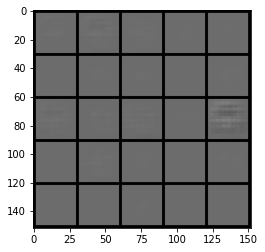

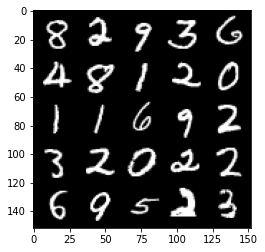

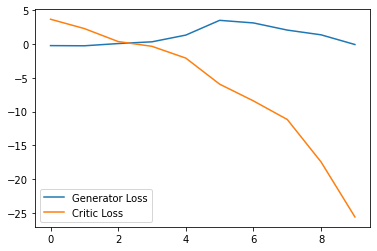

Step 250: Generator loss: 0.3675662999600172, critic loss: -49.015969184875495


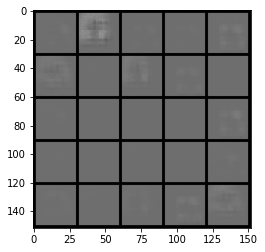

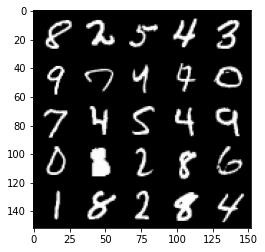

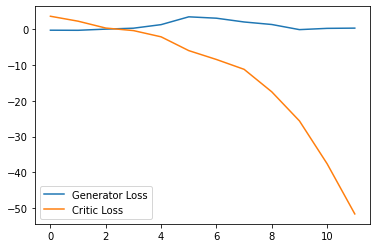

Step 300: Generator loss: 1.7706524163484574, critic loss: -89.81861994934081


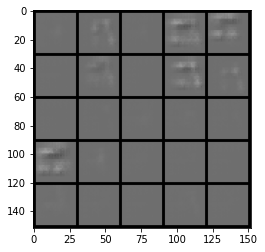

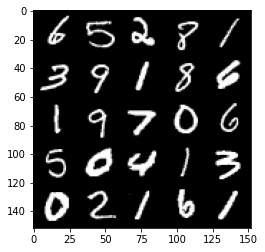

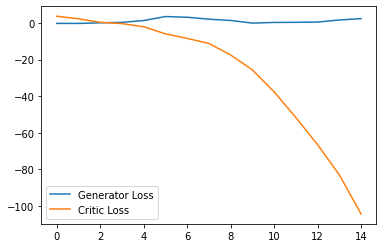

Step 350: Generator loss: 3.712521607875824, critic loss: -140.1062873840332


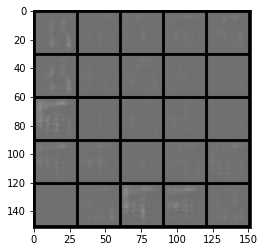

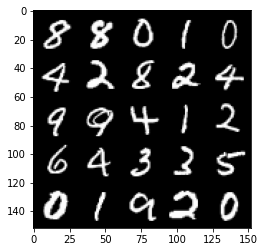

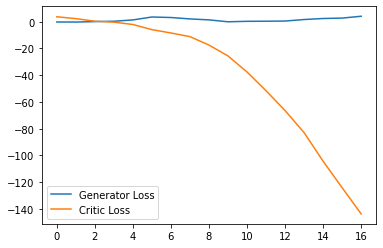

Step 400: Generator loss: 8.129266929626464, critic loss: -195.82624432373046


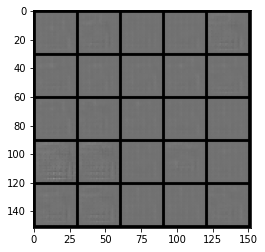

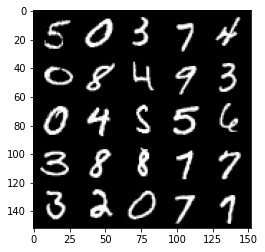

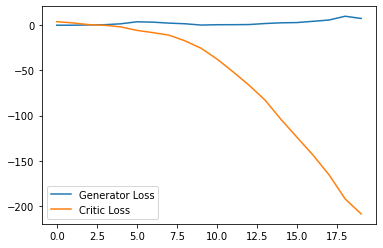

Step 450: Generator loss: 12.691925201416016, critic loss: -253.05110601806643


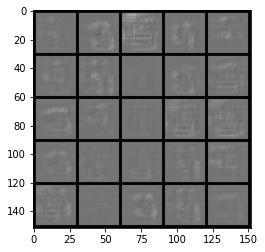

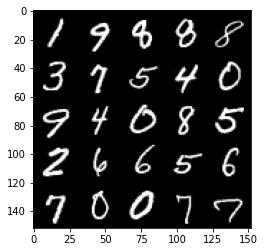

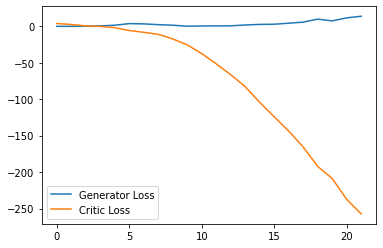

Step 500: Generator loss: 12.647817707061767, critic loss: -304.39116754150393


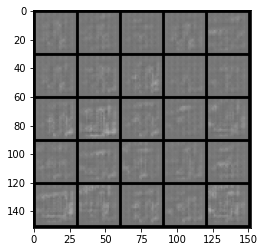

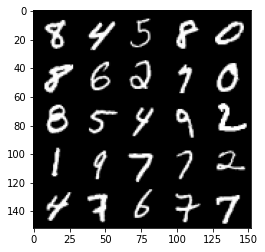

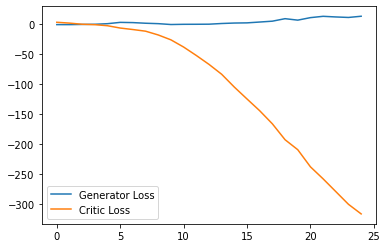

Step 550: Generator loss: 13.535674729347228, critic loss: -357.26072534179696


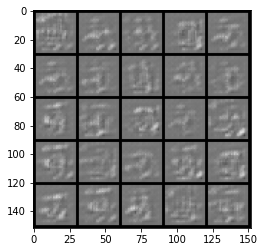

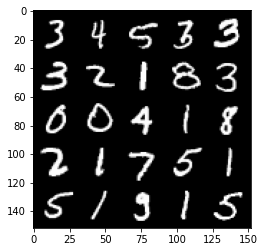

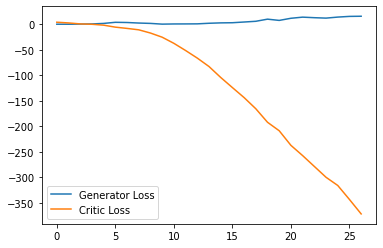

Step 600: Generator loss: -8.754238572120666, critic loss: -317.2818429260253


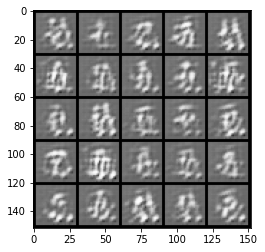

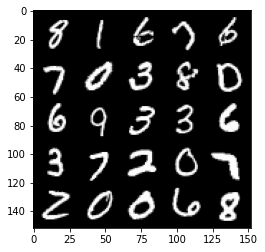

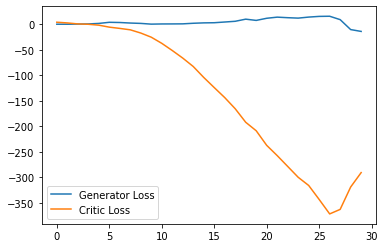

Step 650: Generator loss: 1.2381300377845763, critic loss: -361.6572762145997


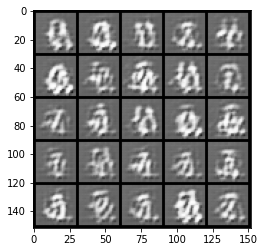

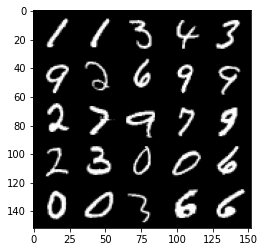

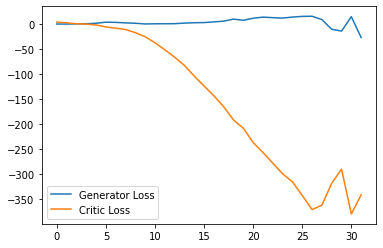

Step 700: Generator loss: 0.789386510848999, critic loss: -385.6845203247069


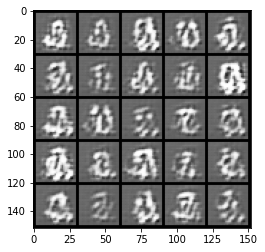

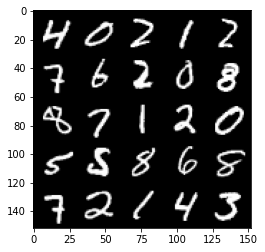

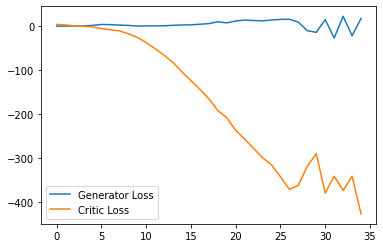

Step 750: Generator loss: -10.308234951496125, critic loss: -352.7064570007324


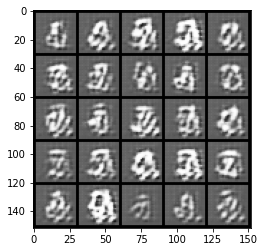

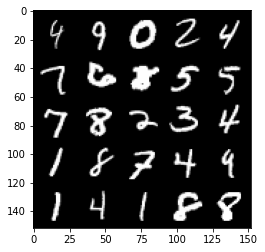

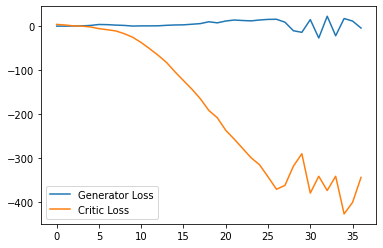

Step 800: Generator loss: -45.06206885337829, critic loss: -304.12275100708


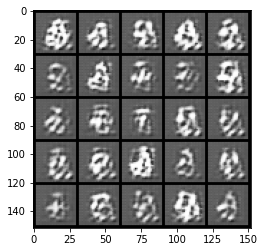

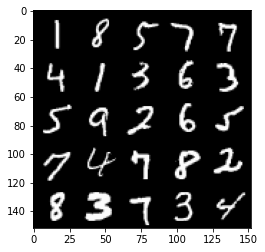

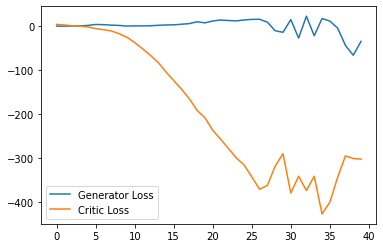

Step 850: Generator loss: -24.686214017868043, critic loss: -271.2774800567628


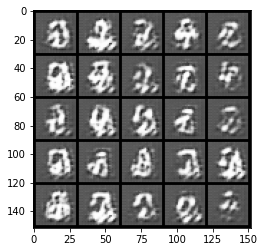

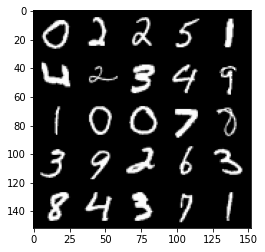

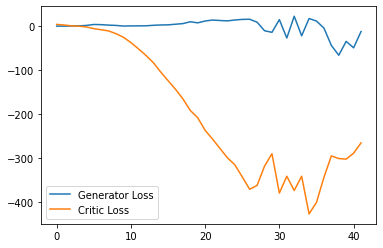

Step 900: Generator loss: -28.121319893598557, critic loss: -146.61114405822747


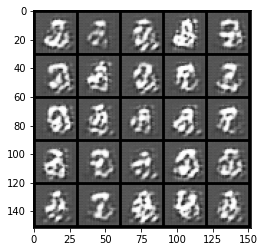

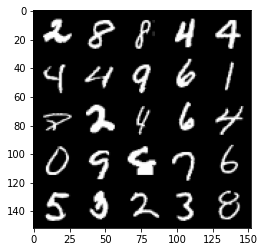

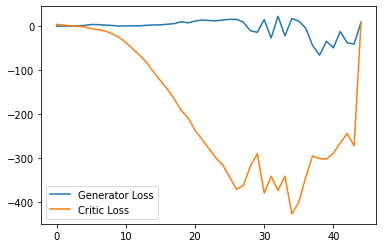

Step 950: Generator loss: -58.472054920196534, critic loss: -184.81357858276365


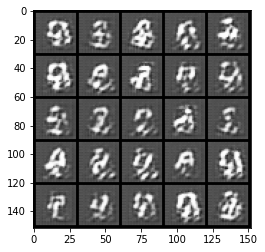

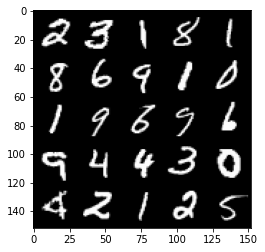

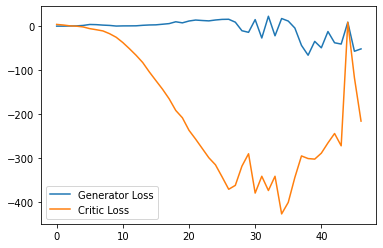

Step 1000: Generator loss: -50.6986599946022, critic loss: -206.93114752197266


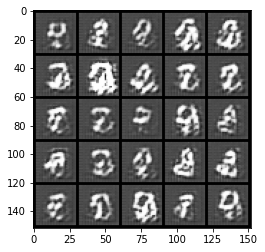

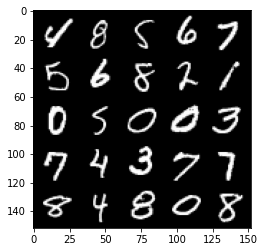

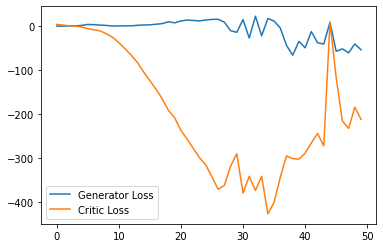

Step 1050: Generator loss: -53.466046485900875, critic loss: -190.00103945922848


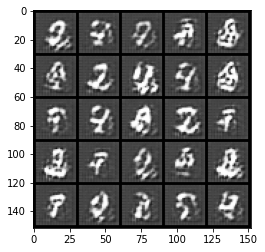

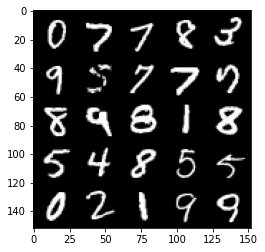

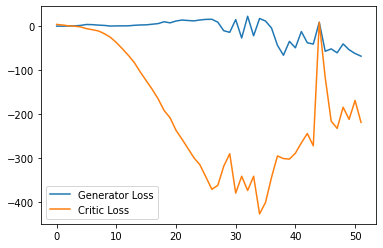

Step 1100: Generator loss: -7.34959139585495, critic loss: -44.56804205322267


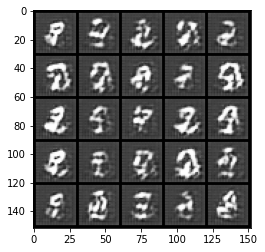

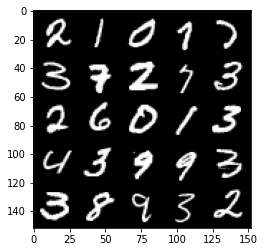

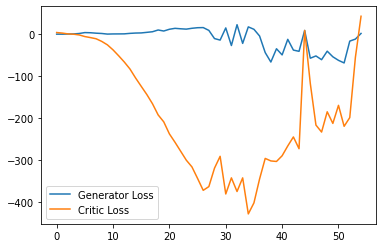

Step 1150: Generator loss: -22.17688727259636, critic loss: -39.16426422882079


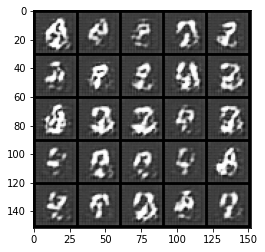

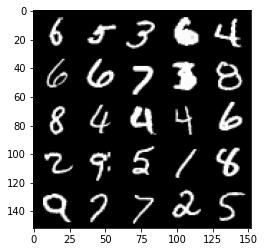

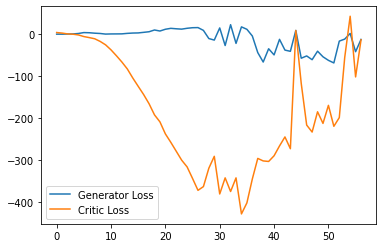

Step 1200: Generator loss: -2.177787484228611, critic loss: 26.834977844238274


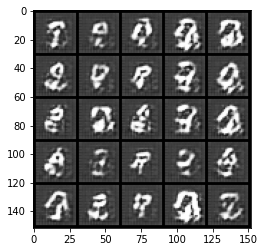

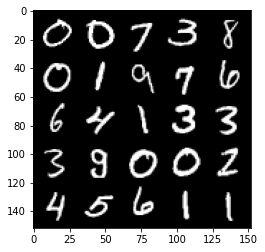

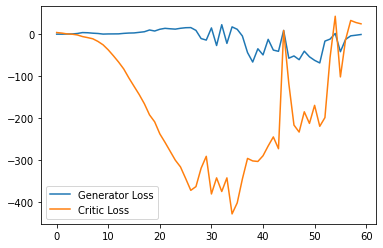

Step 1250: Generator loss: 2.371719592809677, critic loss: 20.681269229888915


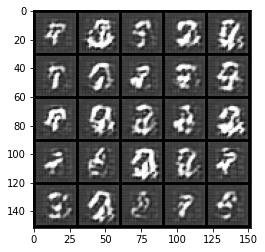

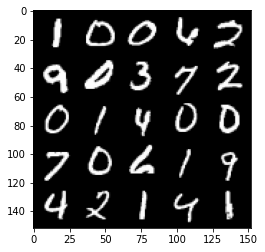

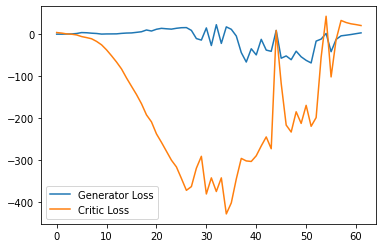

Step 1300: Generator loss: 3.7817058467864992, critic loss: 14.08444919013977


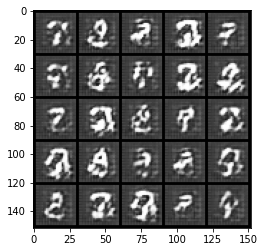

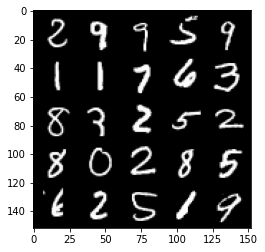

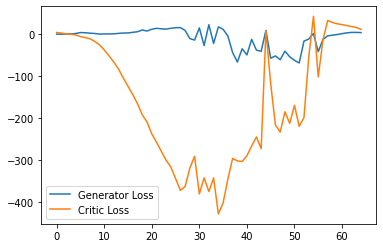

Step 1350: Generator loss: 2.68134845495224, critic loss: 7.239825630187987


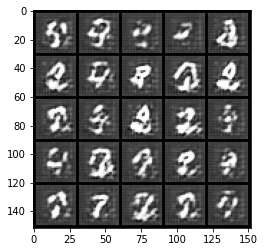

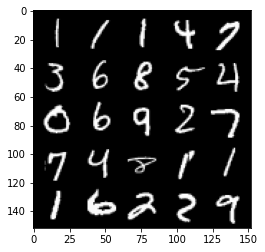

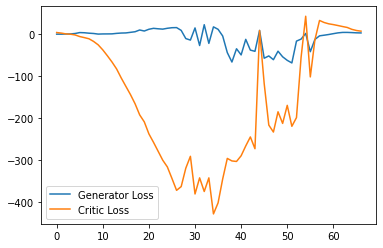

Step 1400: Generator loss: 3.1344954061508177, critic loss: 5.071034896850587


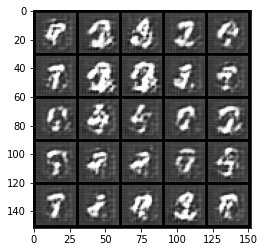

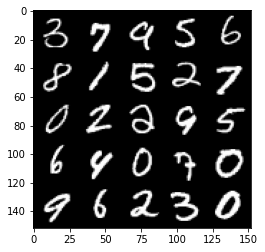

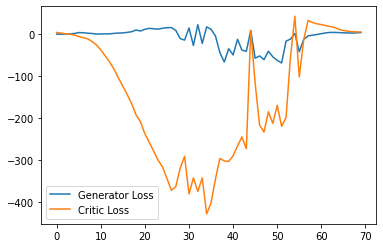

Step 1450: Generator loss: 3.9579660749435424, critic loss: 6.303243875503541


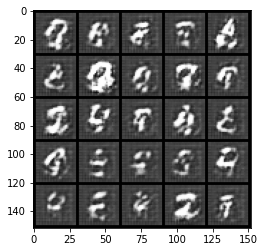

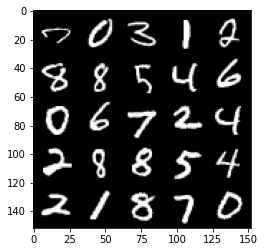

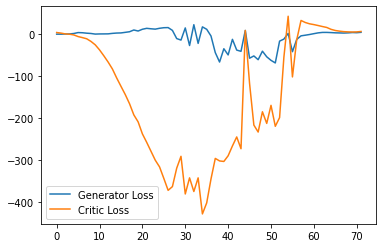

Step 1500: Generator loss: 4.647027864456176, critic loss: 15.529370609283449


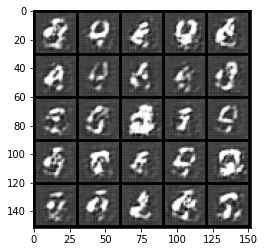

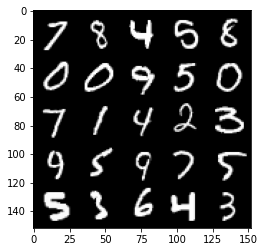

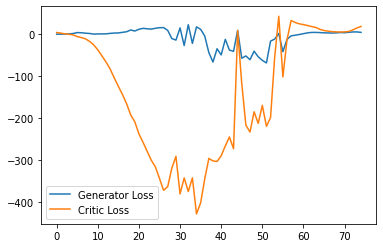

Step 1550: Generator loss: 3.3251730608940124, critic loss: 19.34543490219116


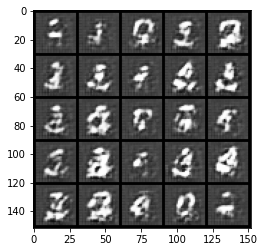

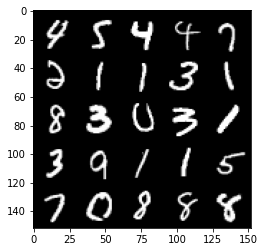

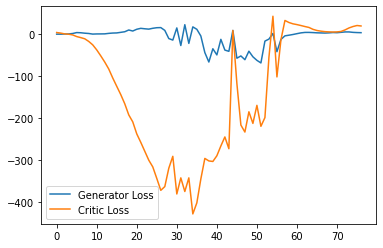

Step 1600: Generator loss: 3.780884232521057, critic loss: 14.713179798126221


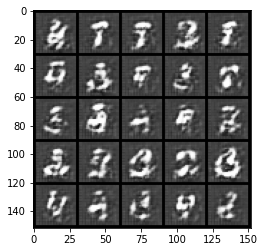

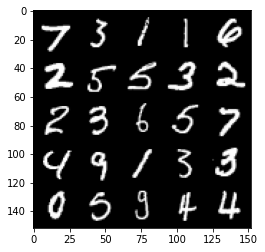

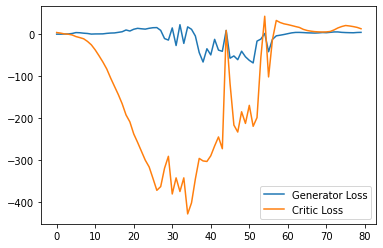

Step 1650: Generator loss: 5.0793819332122805, critic loss: 9.010055065155028


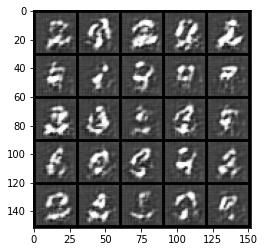

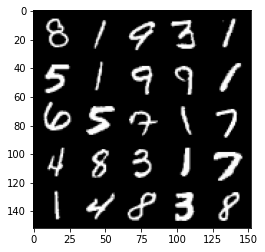

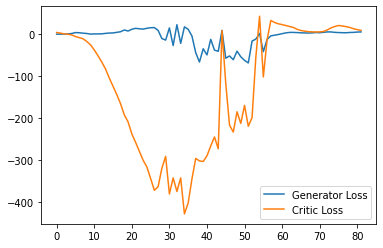

Step 1700: Generator loss: 5.901264820098877, critic loss: 4.829847278594971


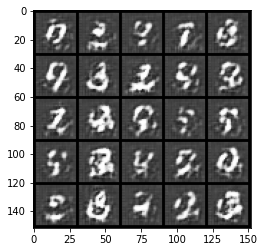

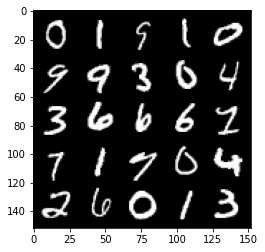

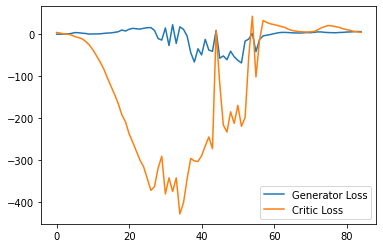

Step 1750: Generator loss: 6.255309514999389, critic loss: -0.27568748855590836


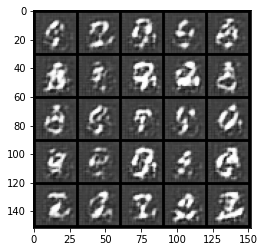

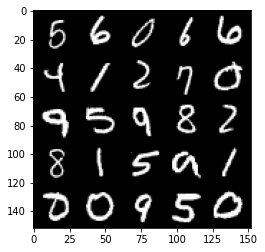

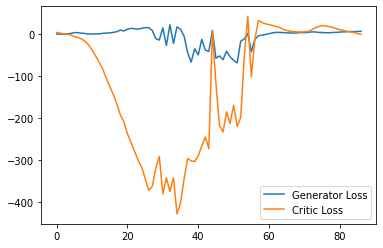

Step 1800: Generator loss: 6.2006695318222045, critic loss: -5.472533546447754


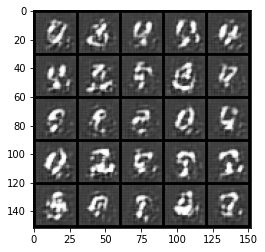

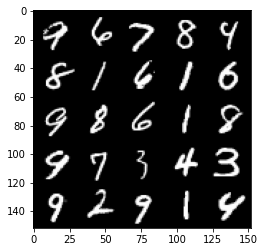

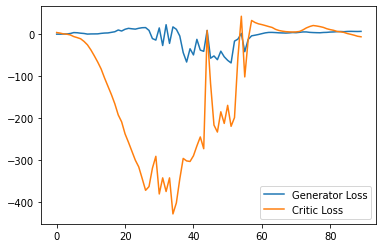

Step 1850: Generator loss: 4.180278694629669, critic loss: -13.475625904083254


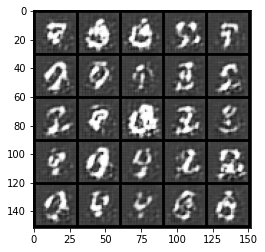

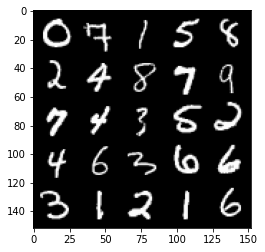

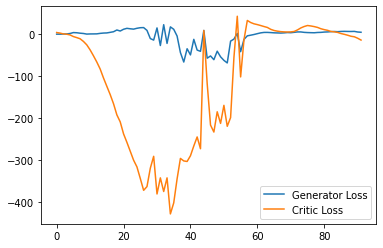

Step 1900: Generator loss: 2.9165125519037245, critic loss: -23.18684360504151


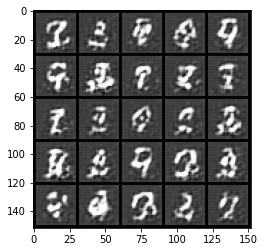

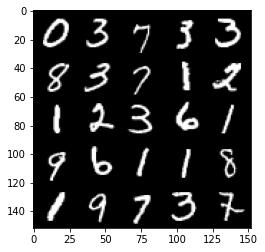

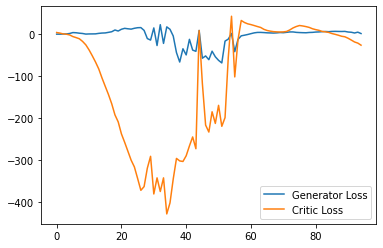

Step 1950: Generator loss: 4.105520396232605, critic loss: -32.68849459075927


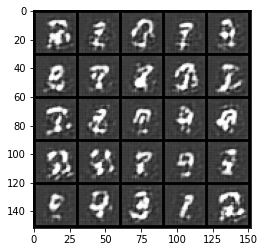

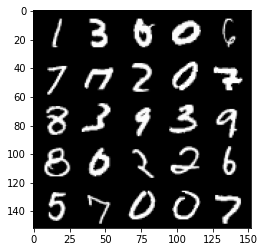

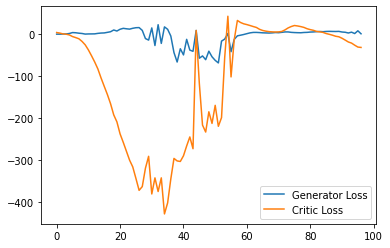

Step 2000: Generator loss: 4.224162968397141, critic loss: -33.5654977836609


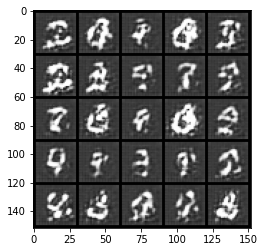

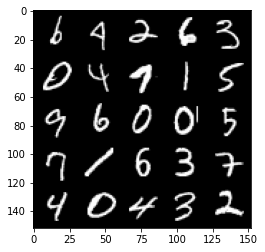

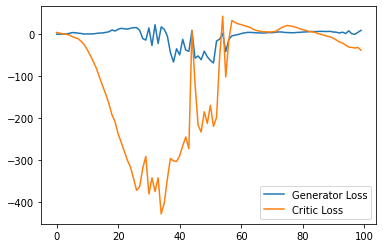

Step 2050: Generator loss: 8.247640318870545, critic loss: -37.189532150268555


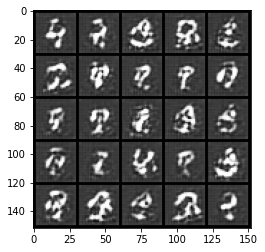

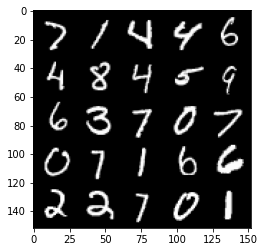

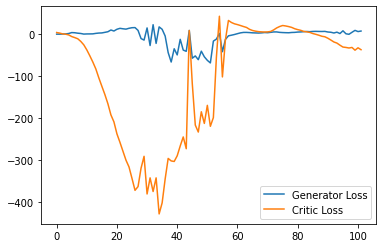

Step 2100: Generator loss: 5.161192333996296, critic loss: -31.486620220184317


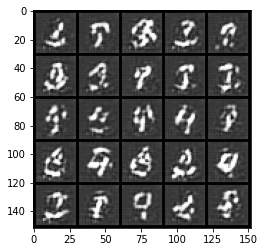

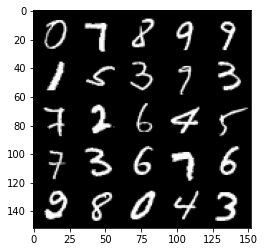

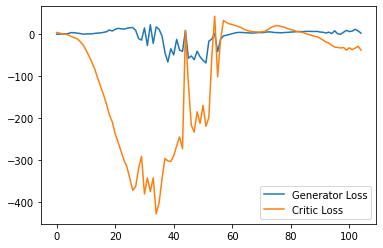

Step 2150: Generator loss: 3.1487636518478395, critic loss: -45.81319653320313


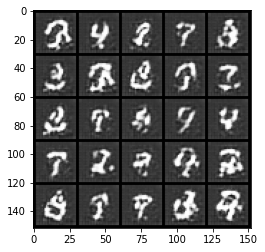

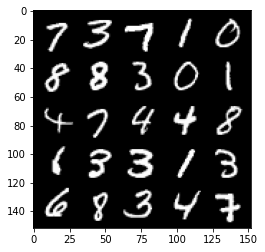

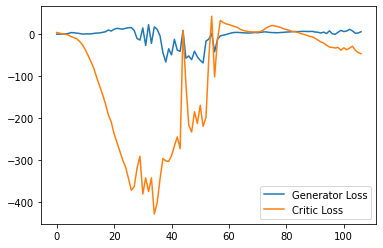

Step 2200: Generator loss: 13.403730477690697, critic loss: -53.194012619018565


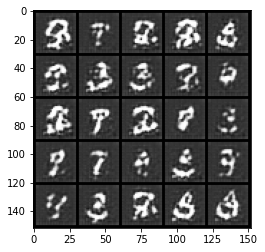

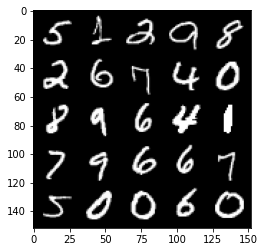

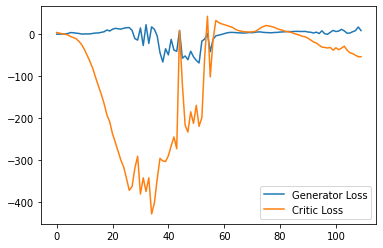

Step 2250: Generator loss: 13.323768985271453, critic loss: -53.697977279663085


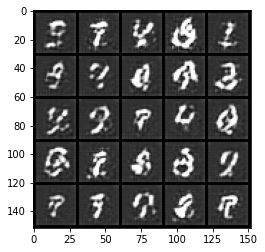

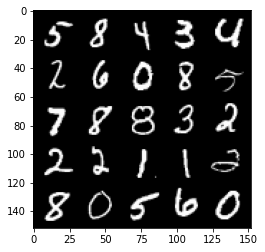

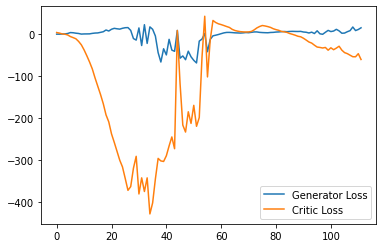

Step 2300: Generator loss: 12.996562489271163, critic loss: 1.7497672958374022


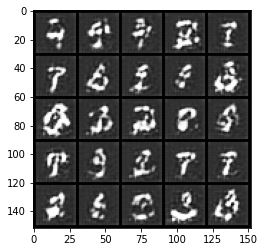

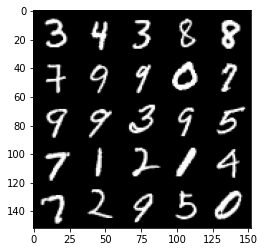

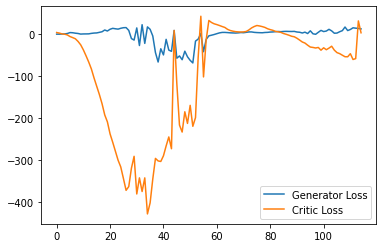

Step 2350: Generator loss: 9.85947109222412, critic loss: 1.302579475402832


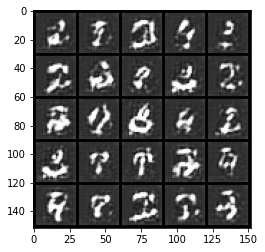

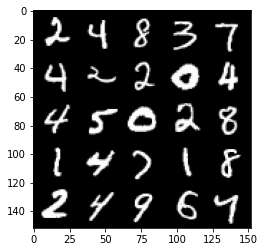

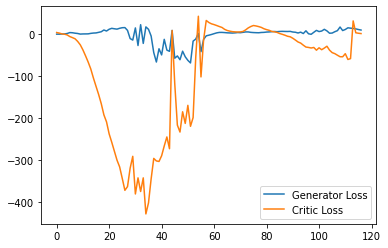

Step 2400: Generator loss: 8.024377021789551, critic loss: -0.20219435405731204


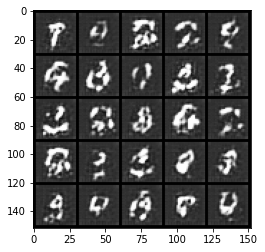

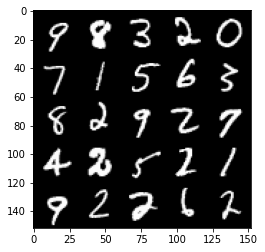

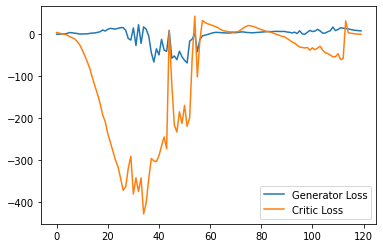

Step 2450: Generator loss: 7.00451542854309, critic loss: -0.8182626419067381


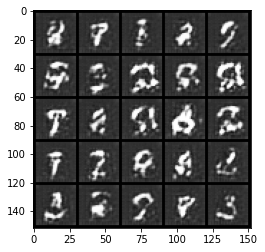

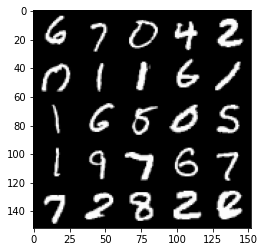

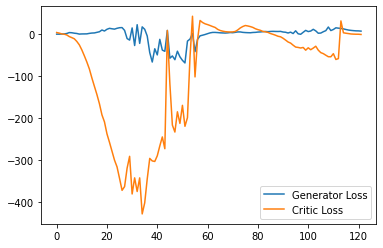

Step 2500: Generator loss: 5.230110530853271, critic loss: -2.105361539840699


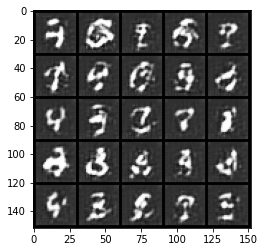

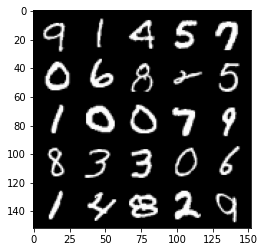

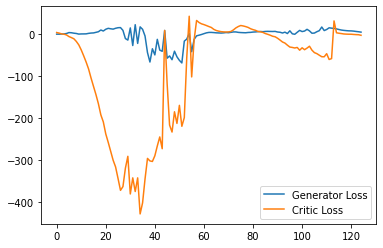

Step 2550: Generator loss: -6.364634389877319, critic loss: -22.254969999313357


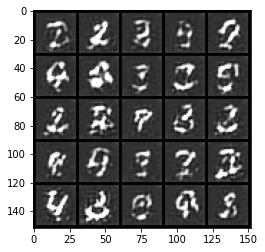

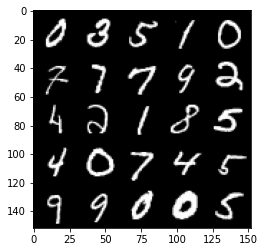

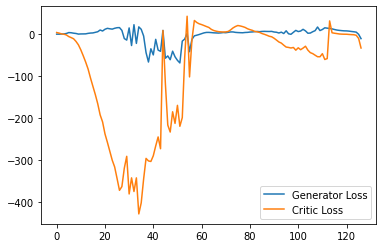

Step 2600: Generator loss: -6.310457116961479, critic loss: -38.064025630950916


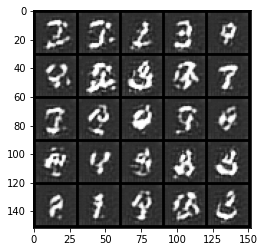

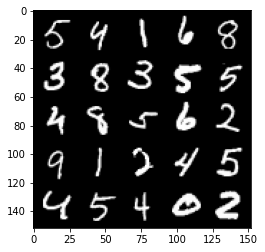

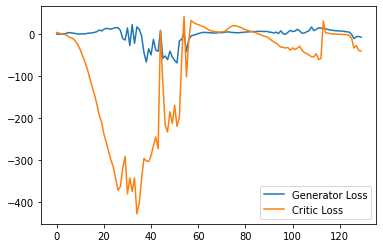

Step 2650: Generator loss: -3.6102814663201572, critic loss: -42.18238402175904


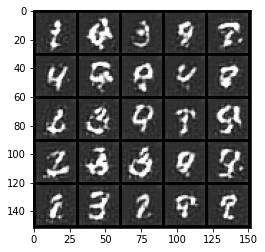

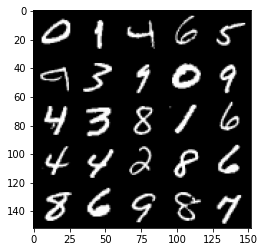

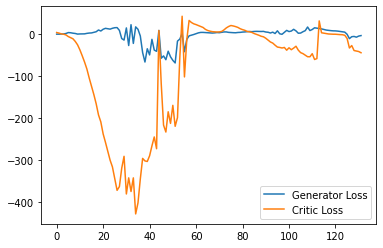

Step 2700: Generator loss: -2.2188806772232055, critic loss: -45.438992969512945


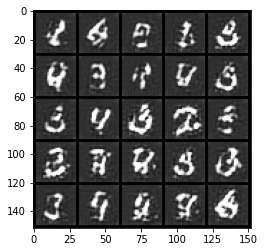

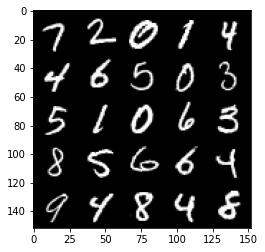

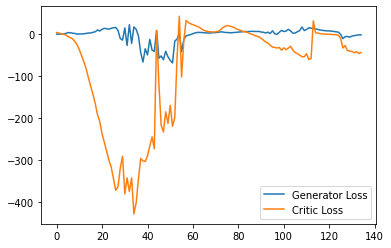

Step 2750: Generator loss: -1.9380235552787781, critic loss: -48.2114212875366


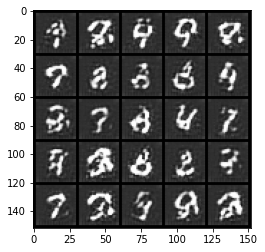

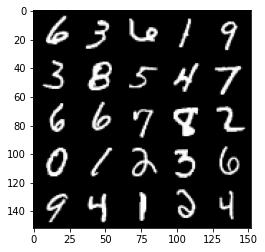

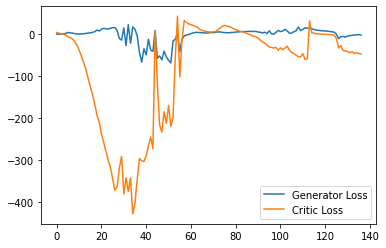

Step 2800: Generator loss: 1.0561998993158341, critic loss: -44.16971309280396


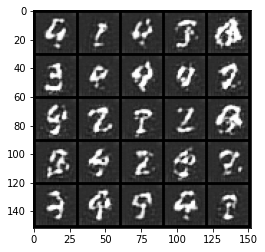

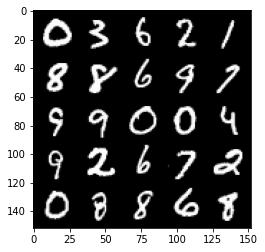

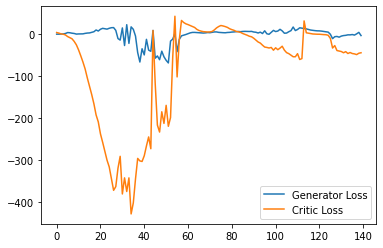

Step 2850: Generator loss: -1.8656783676147461, critic loss: -51.69375562477112


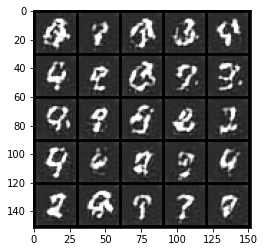

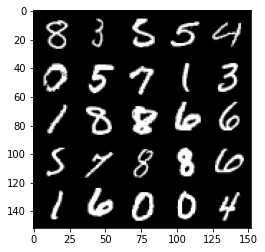

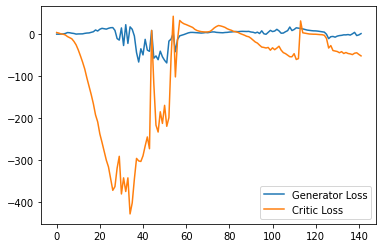

Step 2900: Generator loss: 7.879775701761246, critic loss: -21.021151063919074


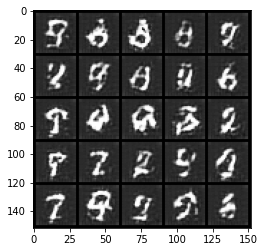

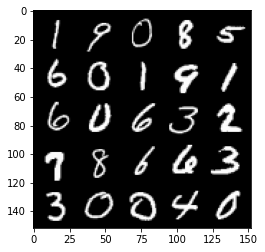

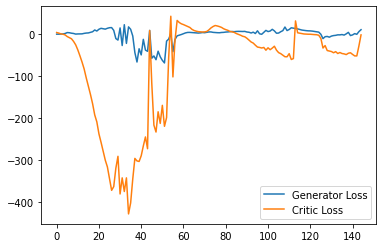

Step 2950: Generator loss: 0.4255448257923126, critic loss: -33.319647144317635


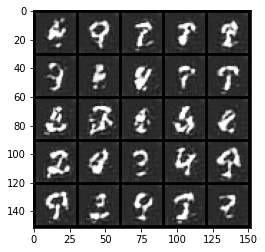

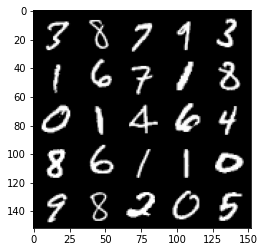

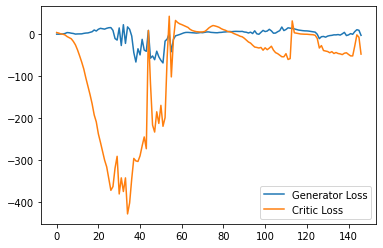

Step 3000: Generator loss: -3.0821749472618105, critic loss: -52.89725025558472


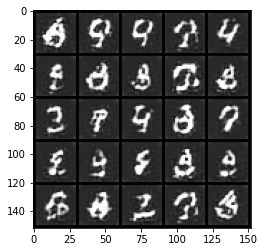

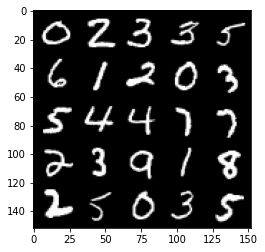

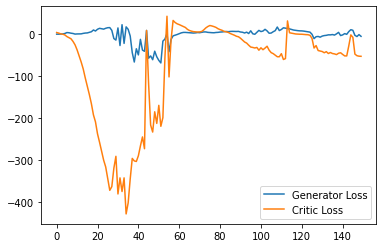

Step 3050: Generator loss: 0.43062729120254517, critic loss: -31.57496152114868


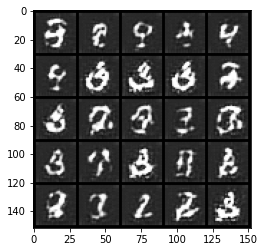

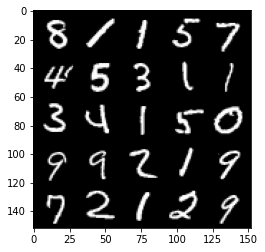

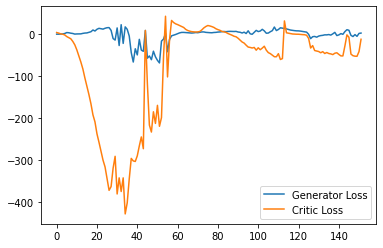

Step 3100: Generator loss: -7.738617143630981, critic loss: -49.65797203063967


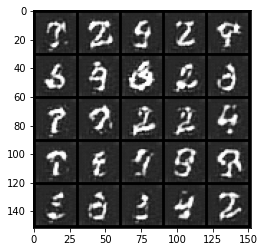

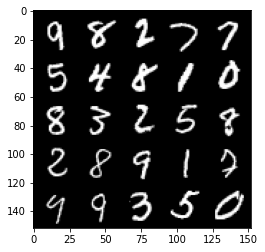

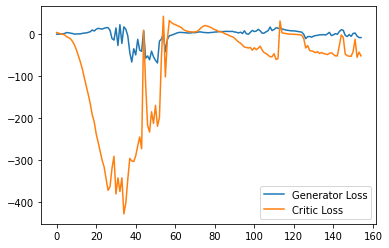

Step 3150: Generator loss: 4.193188557624817, critic loss: -27.58976533699035


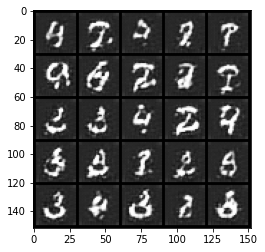

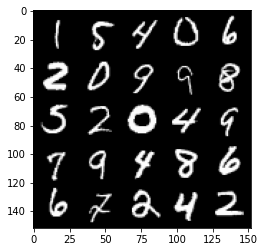

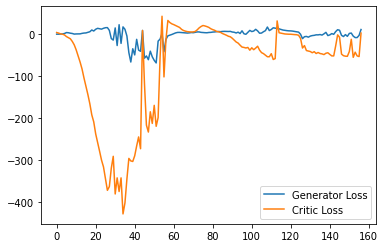

Step 3200: Generator loss: -0.6474595642089844, critic loss: -45.57833293151856


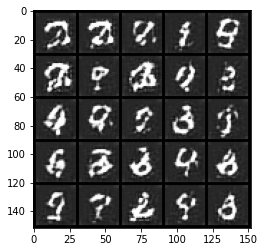

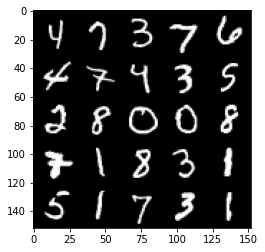

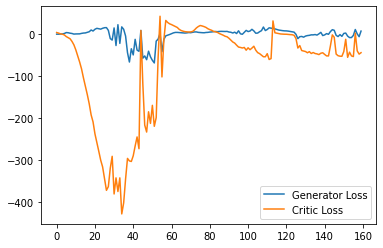

Step 3250: Generator loss: -1.9956697139143944, critic loss: -48.395119688034065


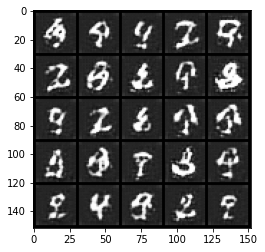

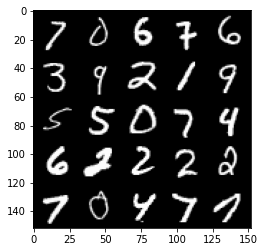

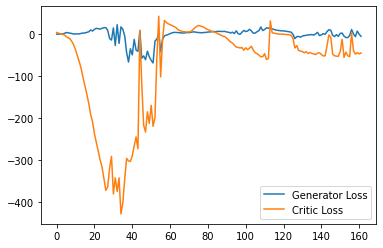

Step 3300: Generator loss: 2.7423334515094755, critic loss: -42.31268102645873


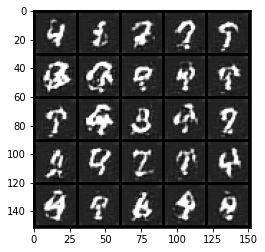

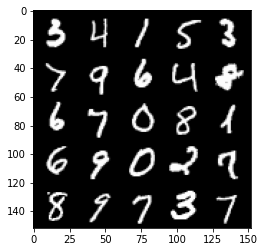

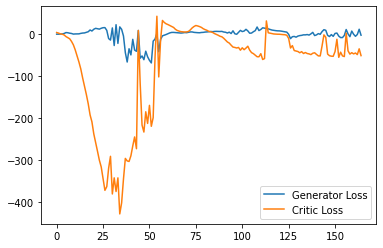

Step 3350: Generator loss: 3.4689367616176607, critic loss: -25.9525094537735


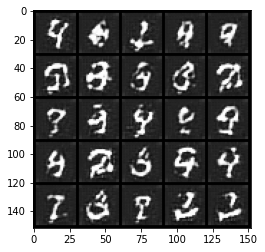

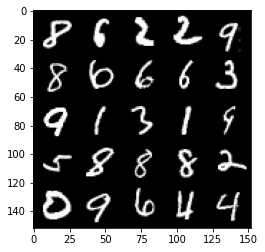

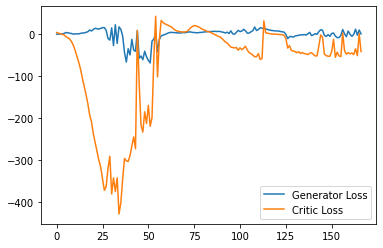

Step 3400: Generator loss: -3.9942412930727005, critic loss: -42.42609927749634


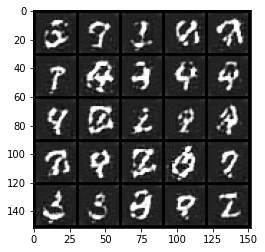

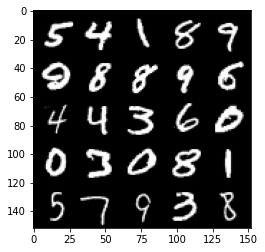

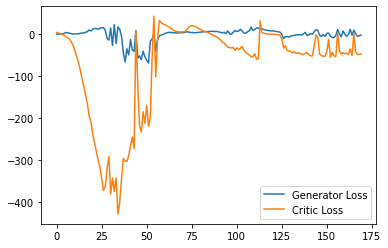

Step 3450: Generator loss: 13.539864635467529, critic loss: 0.01777721214294422


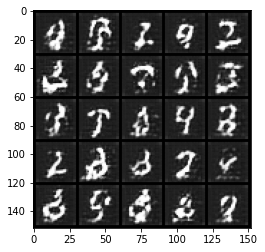

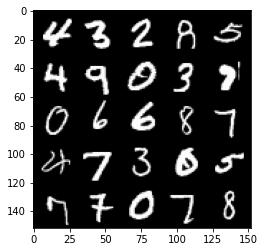

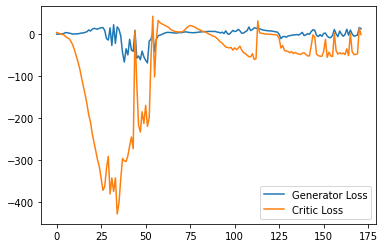

Step 3500: Generator loss: 6.0354761171340945, critic loss: -4.250612411499024


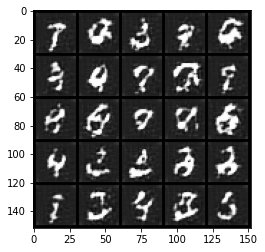

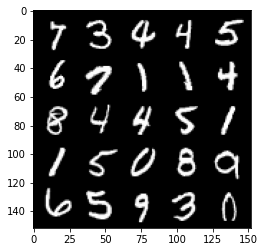

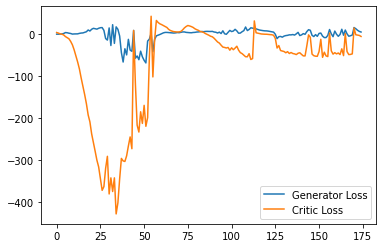

Step 3550: Generator loss: 3.923095347881317, critic loss: -18.540138703346248


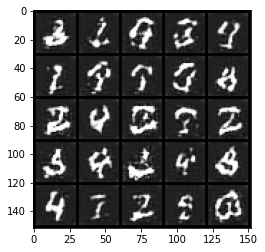

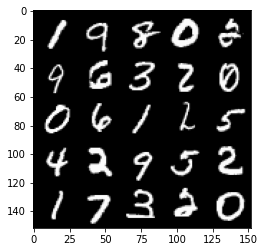

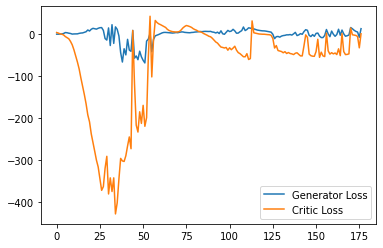

Step 3600: Generator loss: -0.771632829606533, critic loss: -27.01787898254395


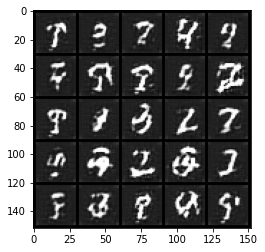

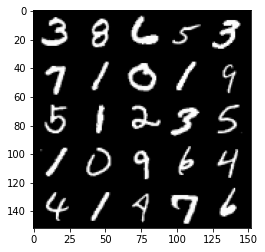

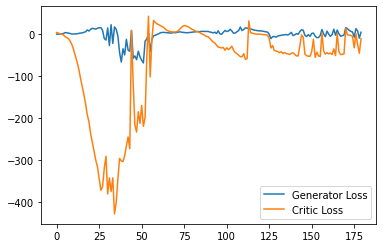

Step 3650: Generator loss: 0.2934448057413101, critic loss: -27.941477275848385


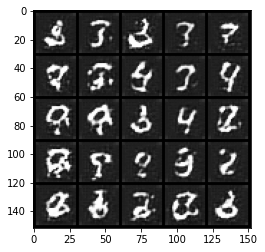

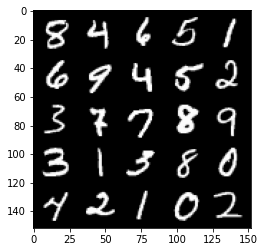

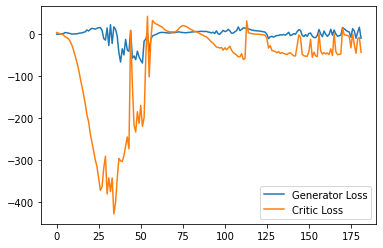

Step 3700: Generator loss: 5.196387681365013, critic loss: -9.75121711778641


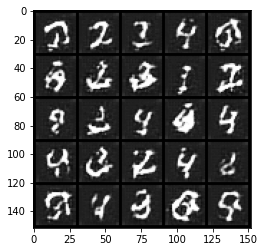

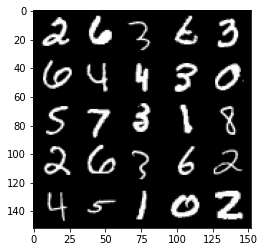

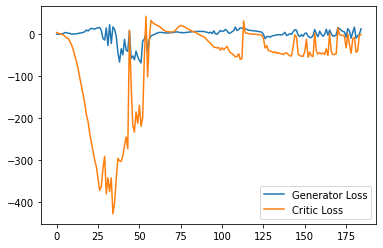

Step 3750: Generator loss: 12.737822399139404, critic loss: -2.1714950914382936


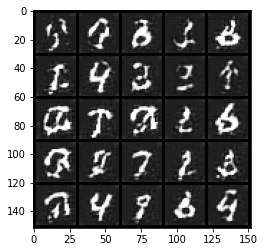

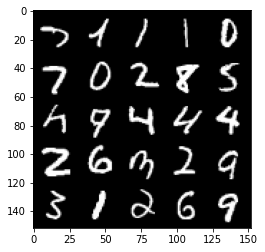

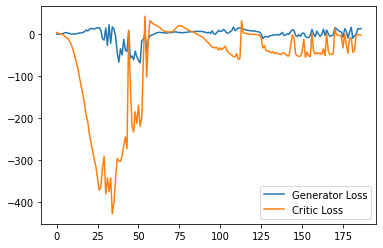

Step 3800: Generator loss: 13.202162704467774, critic loss: -2.5056873393058776


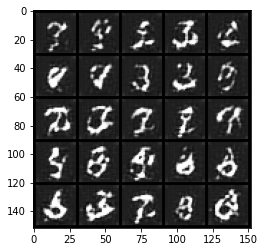

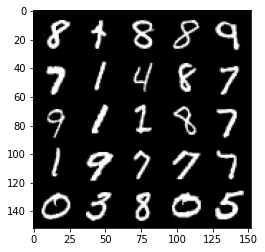

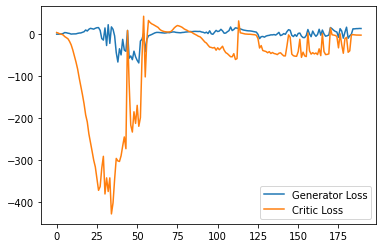

Step 3850: Generator loss: 12.418263664245606, critic loss: -2.6100440416336057


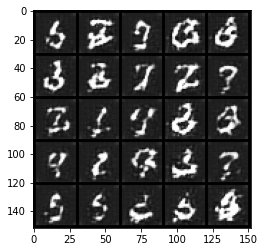

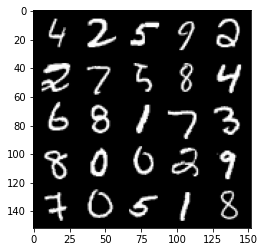

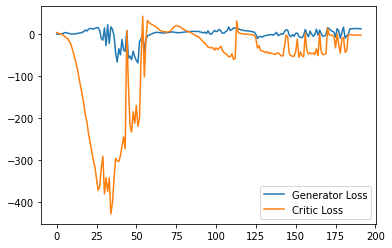

Step 3900: Generator loss: 11.428752193450928, critic loss: -3.0803506622314454


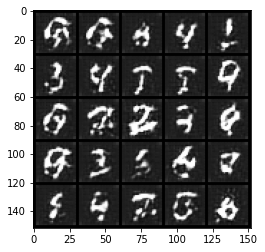

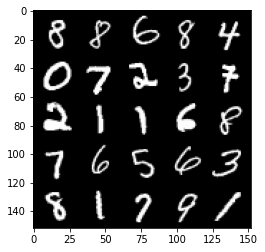

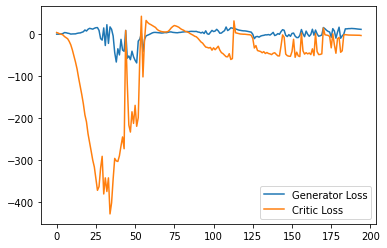

Step 3950: Generator loss: 8.853732923865318, critic loss: -6.923779777526857


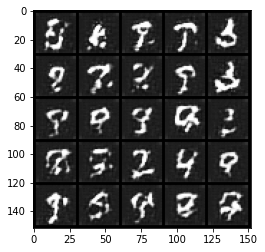

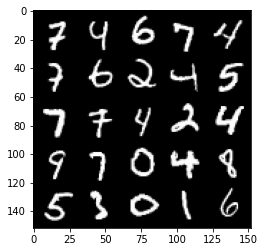

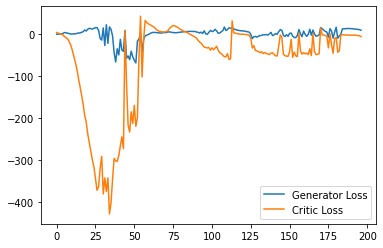

Step 4000: Generator loss: 14.061508376598358, critic loss: 1.3805068407058727


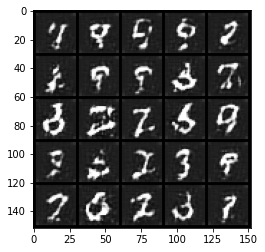

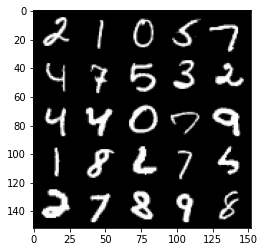

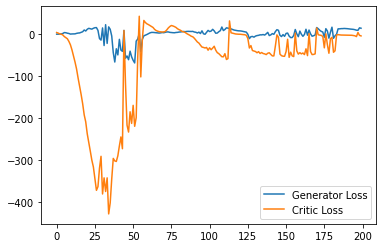

Step 4050: Generator loss: 7.634395806789398, critic loss: -10.825560377120976


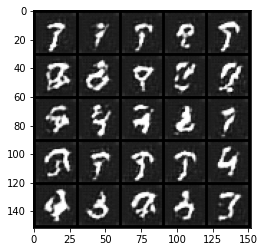

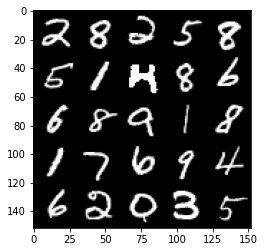

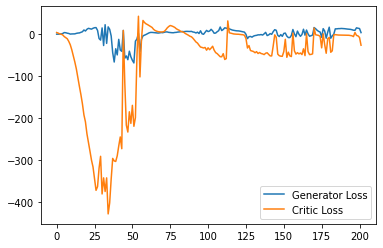

Step 4100: Generator loss: 16.8659023475647, critic loss: -3.761357573509215


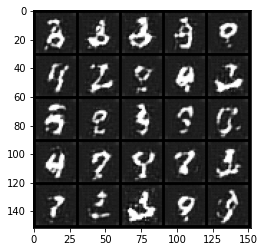

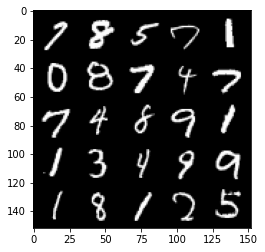

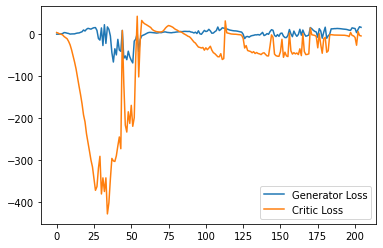

Step 4150: Generator loss: 5.789377390742302, critic loss: -18.34988530921936


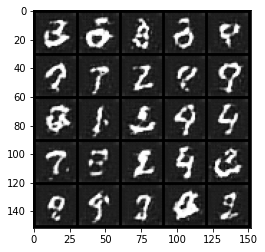

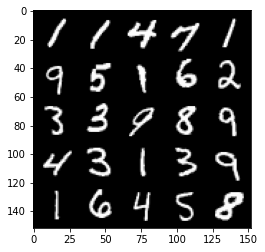

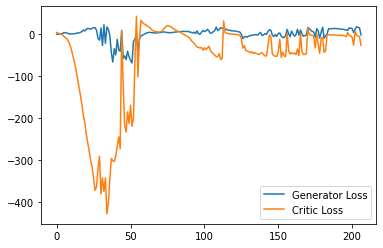

Step 4200: Generator loss: 9.014317396879196, critic loss: -13.125400293350221


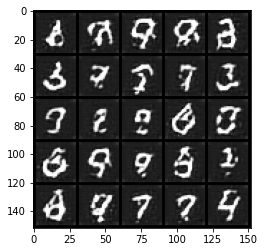

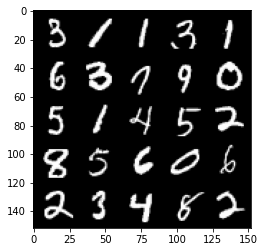

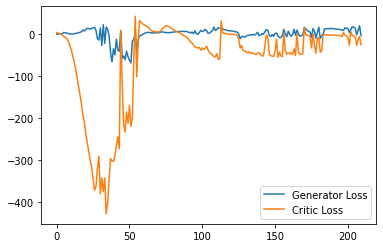

Step 4250: Generator loss: 3.1589834079146386, critic loss: -27.623541349411017


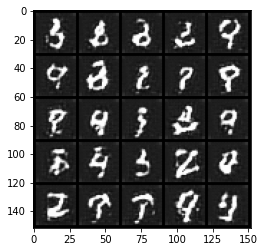

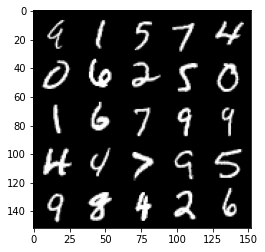

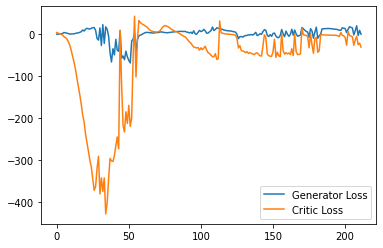

Step 4300: Generator loss: 17.556345958709716, critic loss: 2.4686952104568487


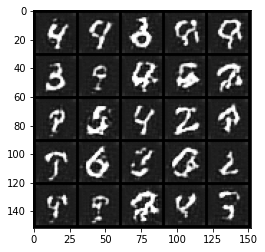

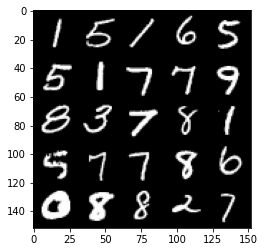

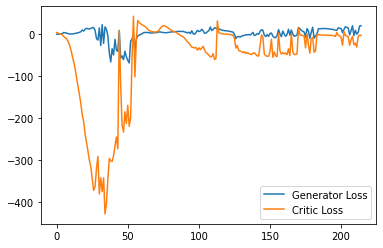

Step 4350: Generator loss: 19.84852081298828, critic loss: -3.560948694229127


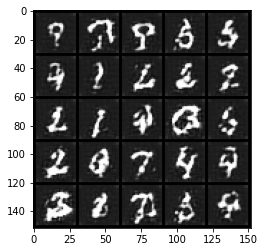

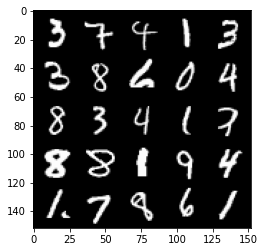

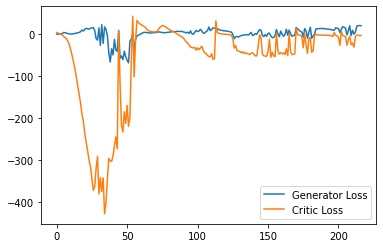

Step 4400: Generator loss: 14.321355264484882, critic loss: -9.631445140838624


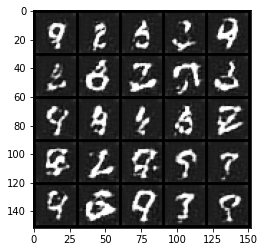

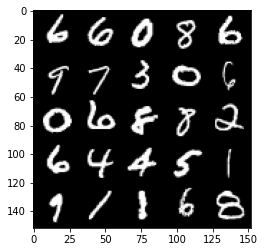

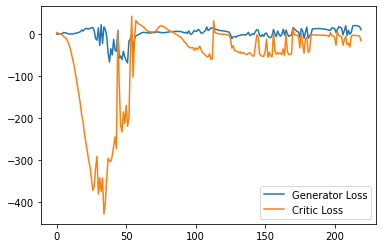

Step 4450: Generator loss: 14.312926745414734, critic loss: -1.6903077239990223


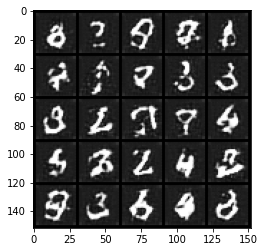

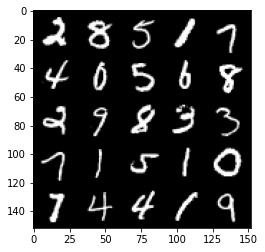

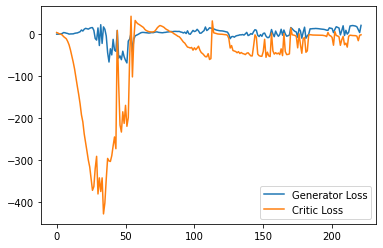

Step 4500: Generator loss: 20.063919868469238, critic loss: -2.278645476341247


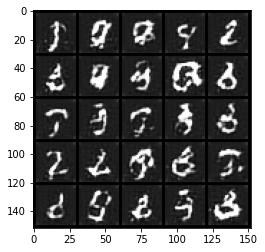

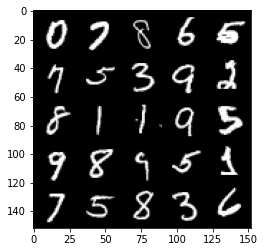

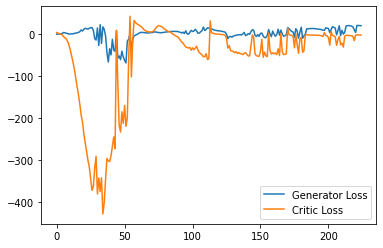

Step 4550: Generator loss: 18.76933361053467, critic loss: -2.8559461107254034


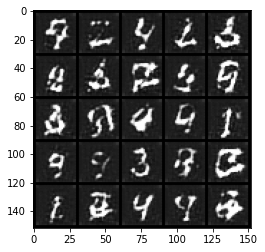

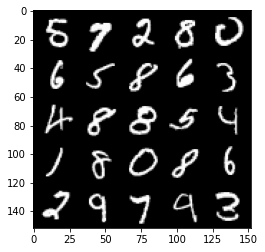

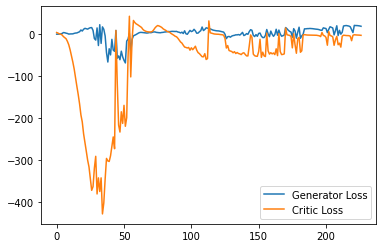

Step 4600: Generator loss: 18.261645011901855, critic loss: -3.6559062099456785


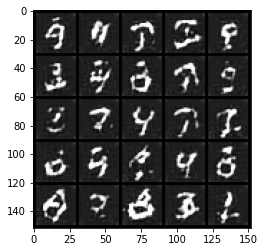

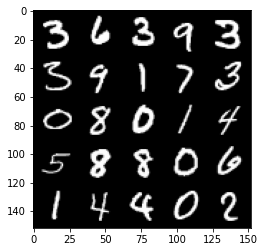

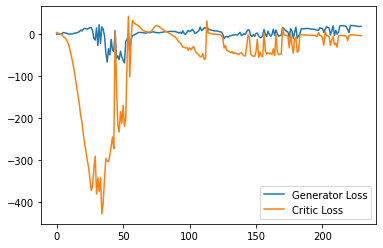

Step 4650: Generator loss: 9.185660808086395, critic loss: -22.340042924880983


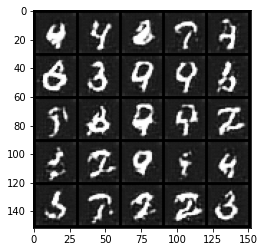

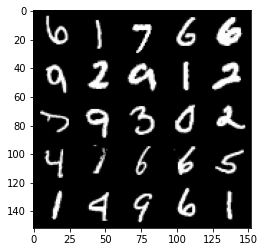

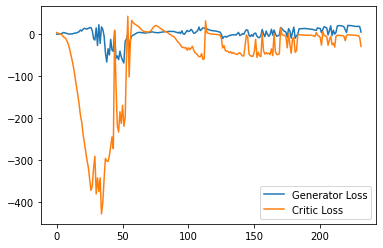

Step 4700: Generator loss: 16.066104979515075, critic loss: -10.601544980049132


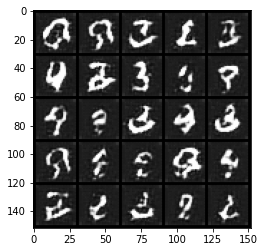

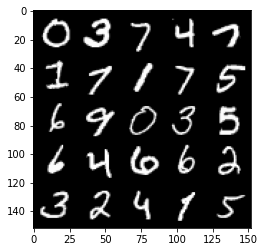

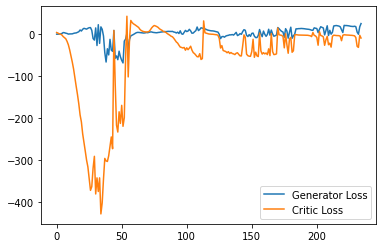

Step 4750: Generator loss: 7.244180632233619, critic loss: -20.620126600265507


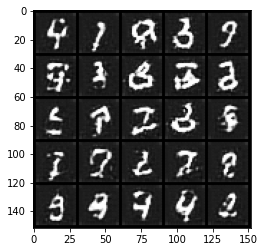

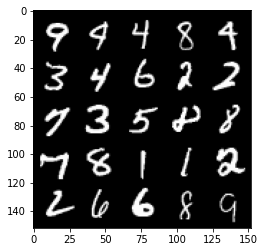

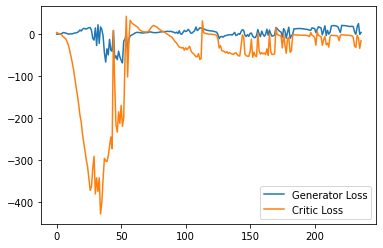

Step 4800: Generator loss: 19.94729038774967, critic loss: -13.988228848457336


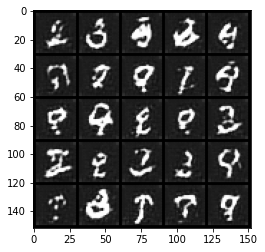

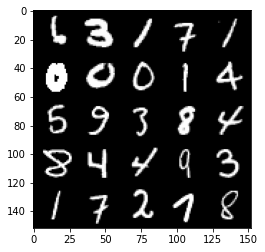

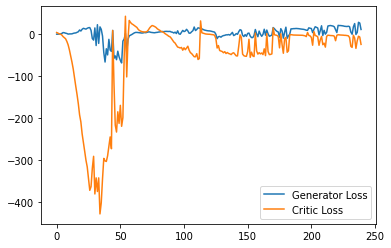

Step 4850: Generator loss: 10.809691420197487, critic loss: -15.964938230514527


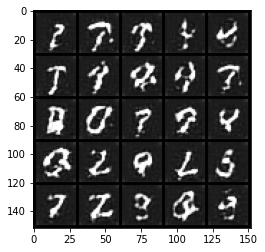

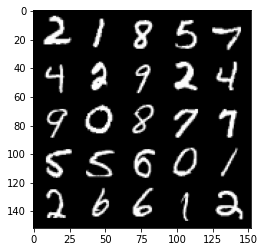

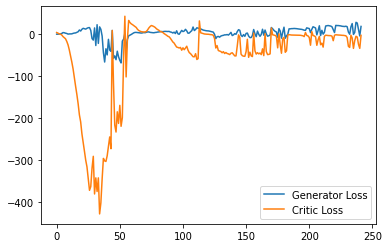

Step 4900: Generator loss: 4.54576699078083, critic loss: -31.40960382843018


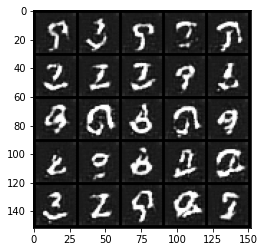

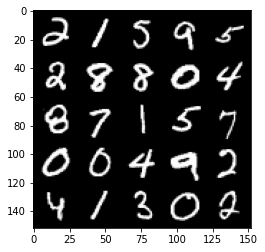

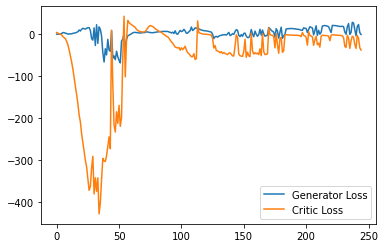

Step 4950: Generator loss: 15.404371361732483, critic loss: 5.163136629581452


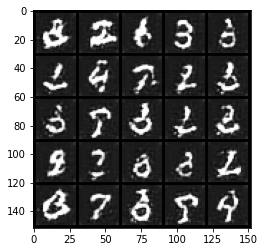

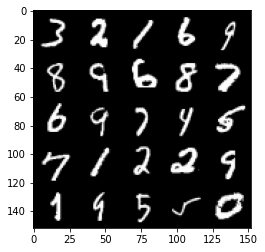

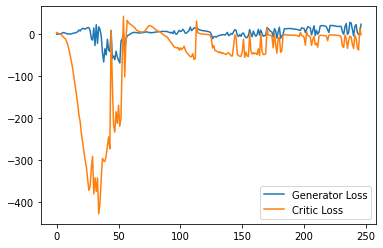

Step 5000: Generator loss: 20.341052169799806, critic loss: -2.4121131181716917


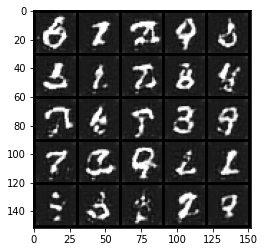

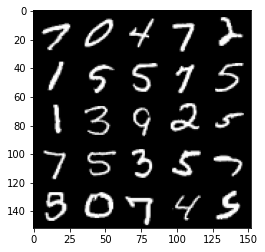

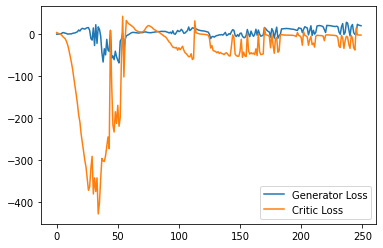

Step 5050: Generator loss: 19.15632034301758, critic loss: -2.7095279884338375


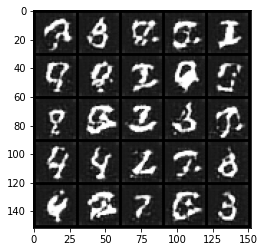

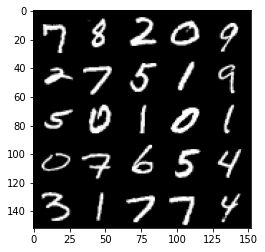

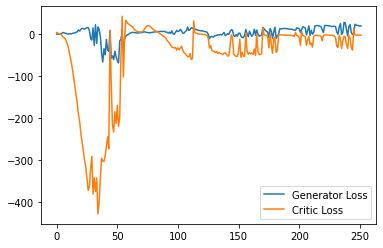

Step 5100: Generator loss: 18.12734329223633, critic loss: -2.6861676383018493


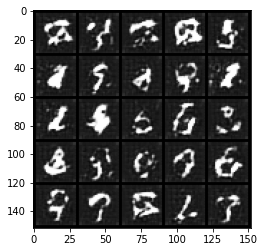

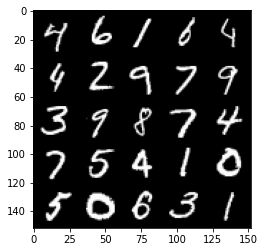

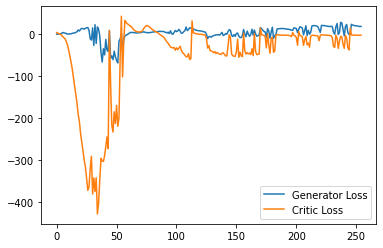

Step 5150: Generator loss: 19.08851146697998, critic loss: -3.93859189414978


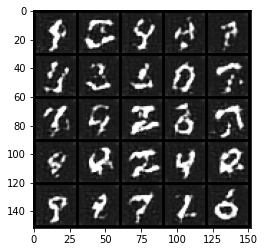

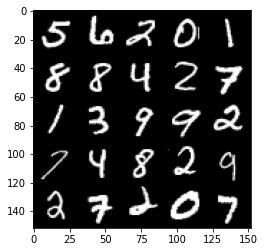

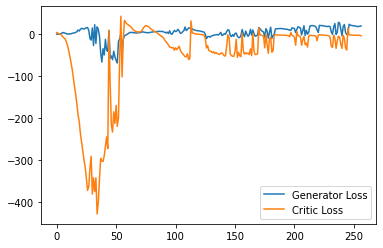

Step 5200: Generator loss: 8.149969218969344, critic loss: -20.515378561019894


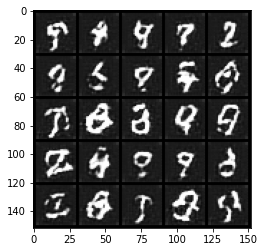

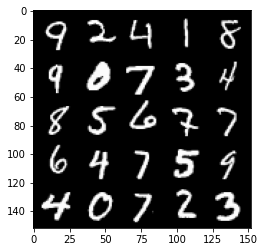

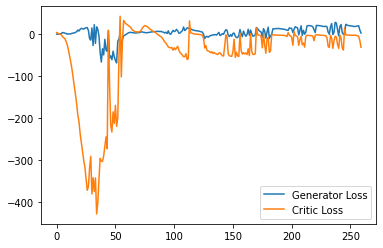

Step 5250: Generator loss: 12.530681035220622, critic loss: -13.411132904052733


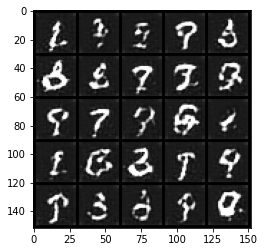

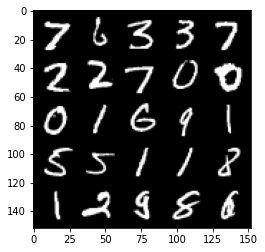

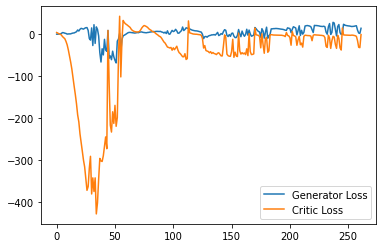

Step 5300: Generator loss: 27.758162384033202, critic loss: -3.194379748344421


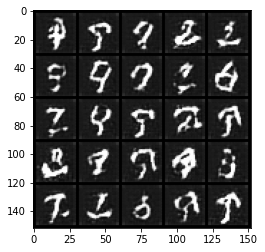

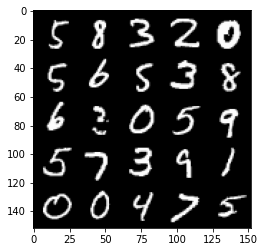

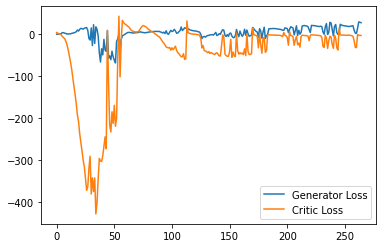

Step 5350: Generator loss: 23.45609161376953, critic loss: -4.509695626258849


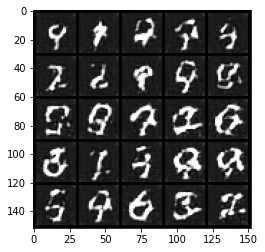

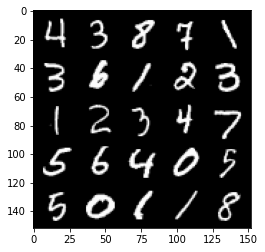

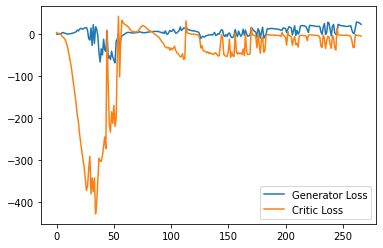

Step 5400: Generator loss: 4.034812579154968, critic loss: -25.032656739234927


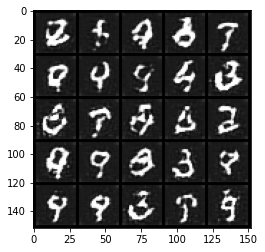

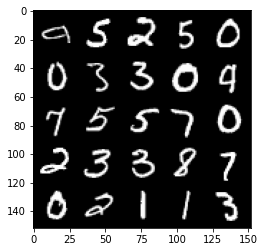

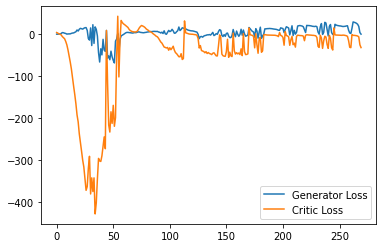

Step 5450: Generator loss: 16.658429988622665, critic loss: -10.832327627182007


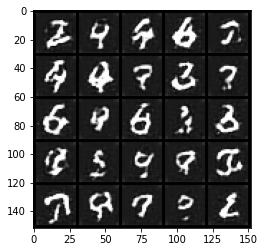

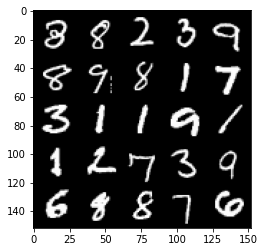

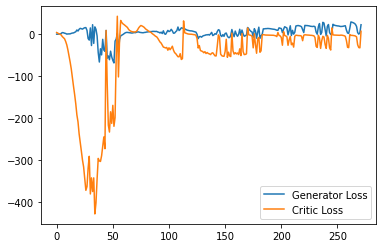

Step 5500: Generator loss: 24.622932896614074, critic loss: -8.274464939117433


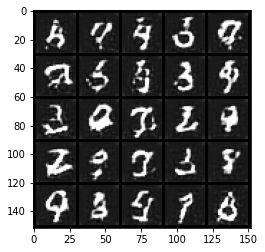

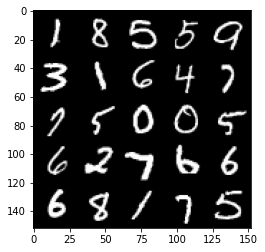

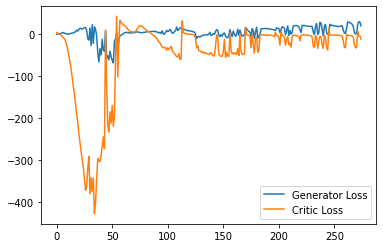

Step 5550: Generator loss: 10.474599217474461, critic loss: -25.40675020980835


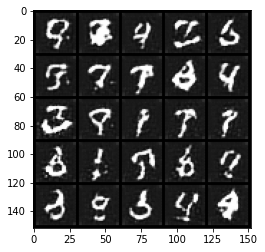

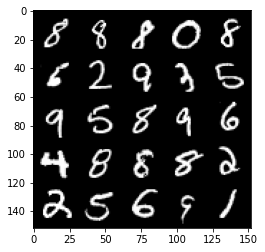

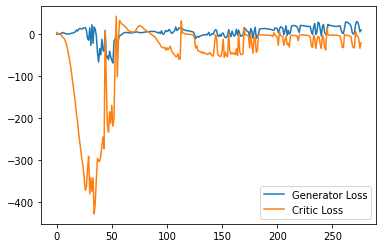

Step 5600: Generator loss: 5.045204737484455, critic loss: -23.968458227157583


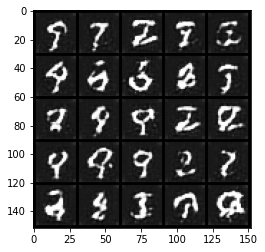

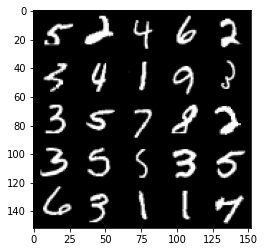

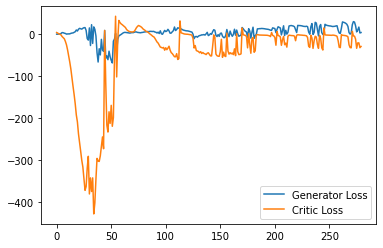

Step 5650: Generator loss: 17.25984118461609, critic loss: -9.340676484584806


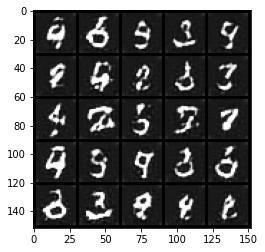

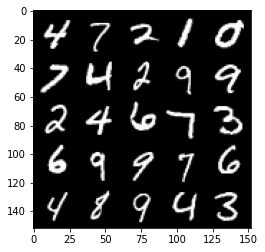

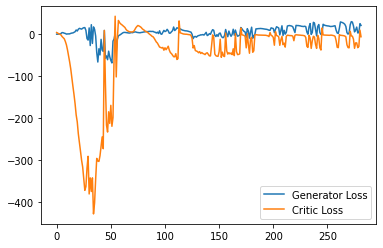

Step 5700: Generator loss: 22.80757267951965, critic loss: 7.71901603507996


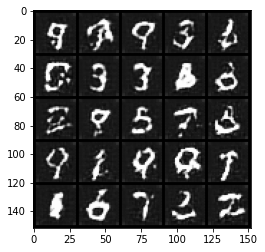

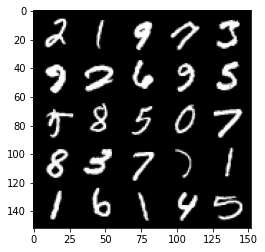

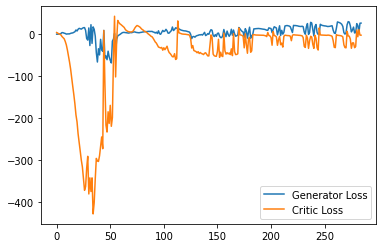

Step 5750: Generator loss: 24.598444519042967, critic loss: -2.8493646473884575


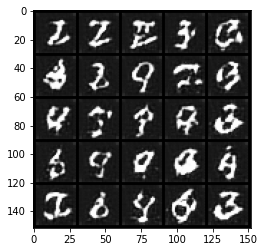

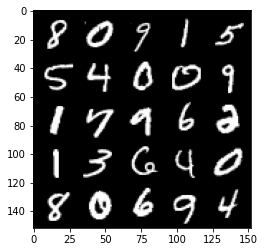

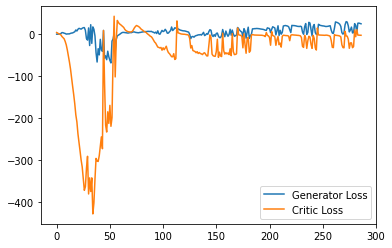

Step 5800: Generator loss: 22.549281578063965, critic loss: -3.5419689683914184


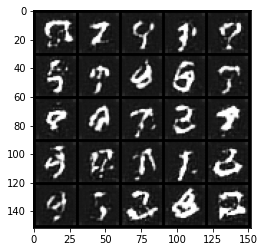

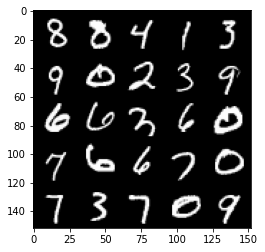

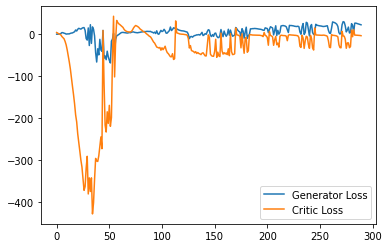

Step 5850: Generator loss: 17.128832998275758, critic loss: -8.612660742759706


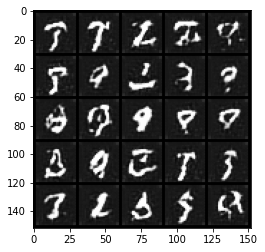

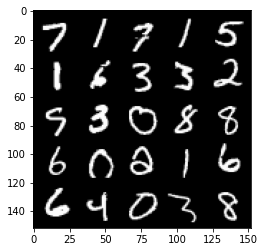

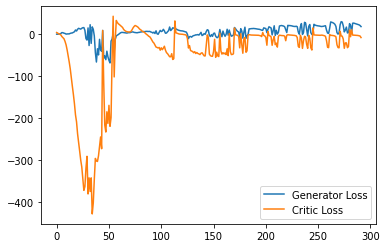

Step 5900: Generator loss: 2.673618733882904, critic loss: -28.475617681503294


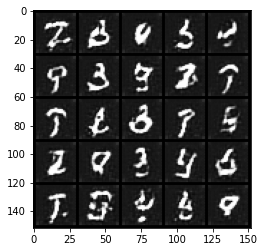

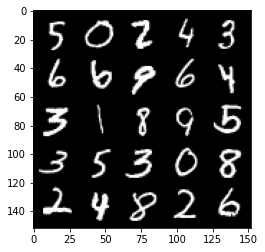

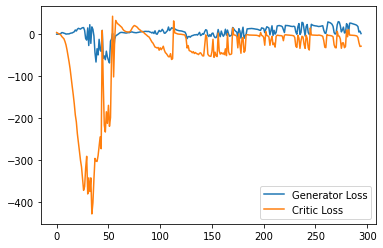

Step 5950: Generator loss: 25.395950713157653, critic loss: 12.697916263103481


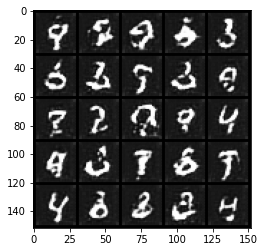

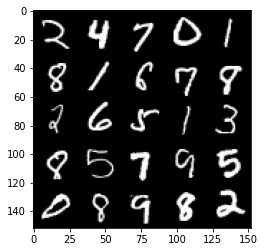

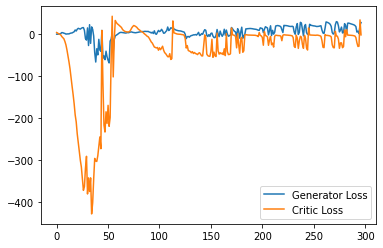

Step 6000: Generator loss: 25.408354682922365, critic loss: -1.9792019686698907


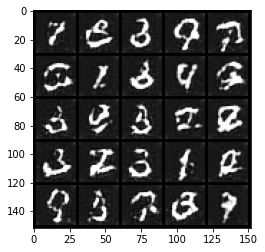

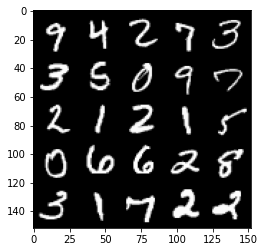

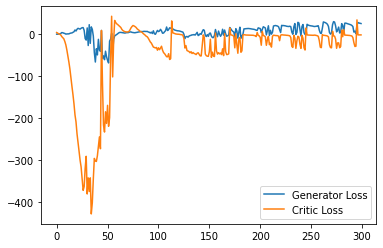

Step 6050: Generator loss: 25.21415843963623, critic loss: -2.144341656684875


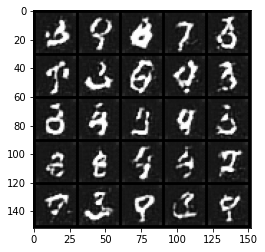

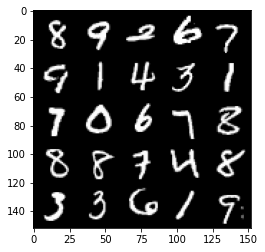

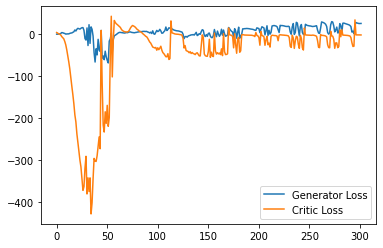

Step 6100: Generator loss: 25.289554252624512, critic loss: -2.5348764662742607


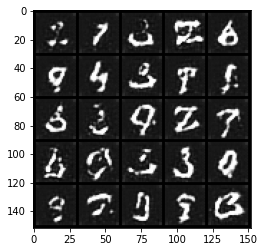

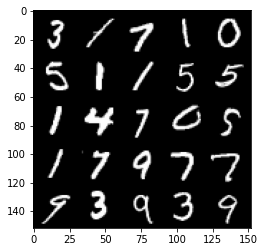

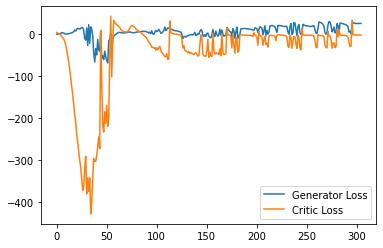

Step 6150: Generator loss: 25.341171531677247, critic loss: -2.9853008012771602


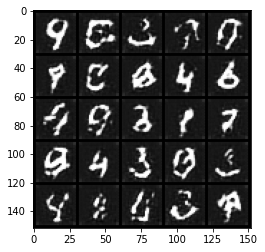

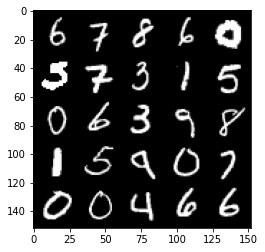

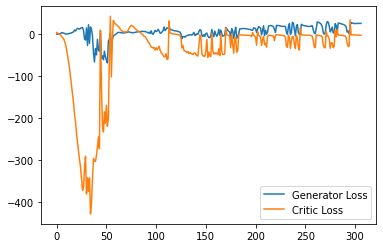

Step 6200: Generator loss: 24.811855010986328, critic loss: -3.6024889049530033


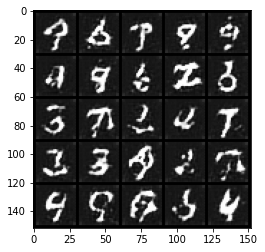

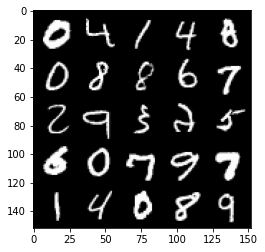

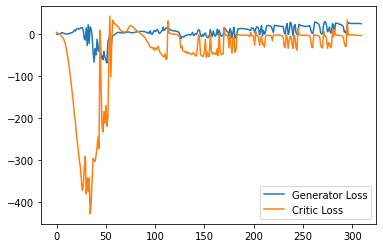

Step 6250: Generator loss: 25.131367263793944, critic loss: -4.676823879241942


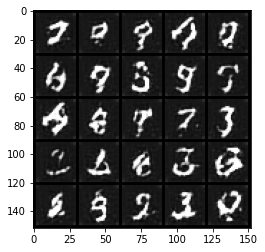

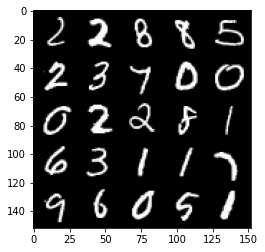

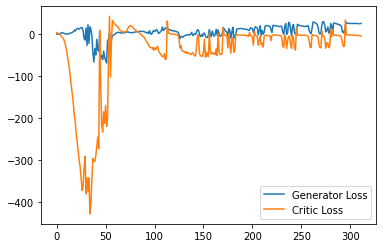

Step 6300: Generator loss: 17.667443893551827, critic loss: -10.207219923019405


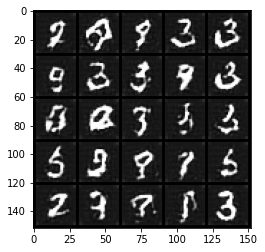

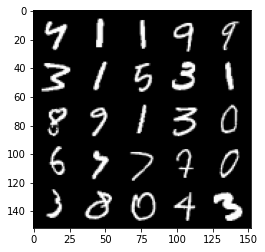

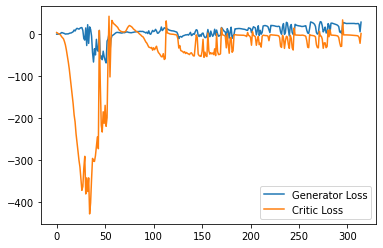

Step 6350: Generator loss: 15.969936011433601, critic loss: -20.45476416778565


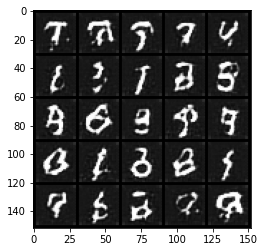

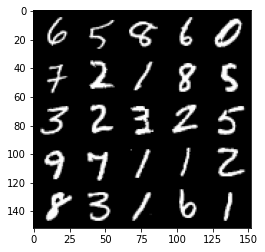

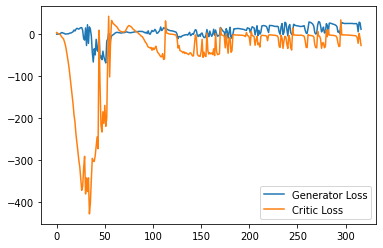

Step 6400: Generator loss: 11.615321183204651, critic loss: -17.584010273933412


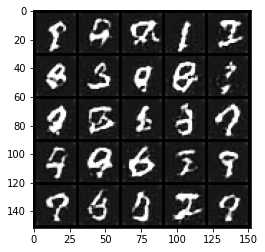

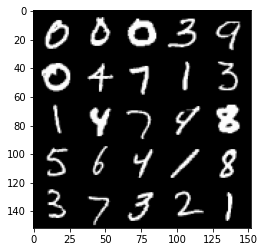

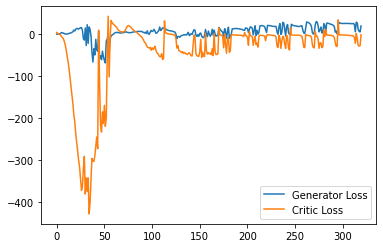

Step 6450: Generator loss: 27.694394874572755, critic loss: -4.958624038696288


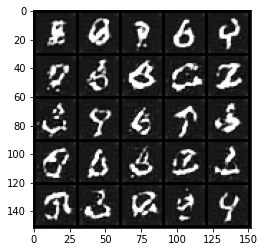

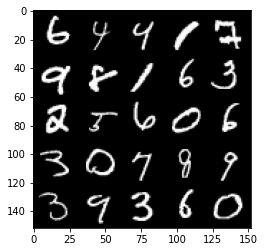

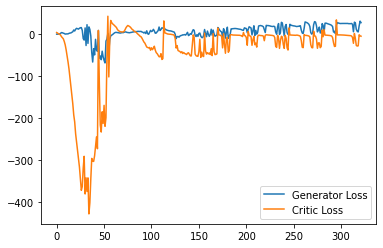

Step 6500: Generator loss: 19.375241261720657, critic loss: -0.6176299076080345


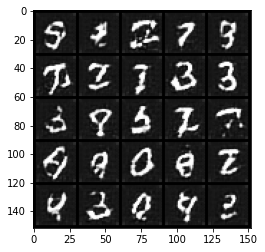

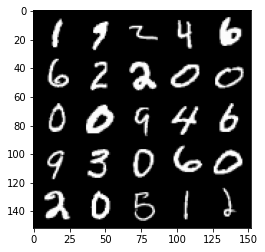

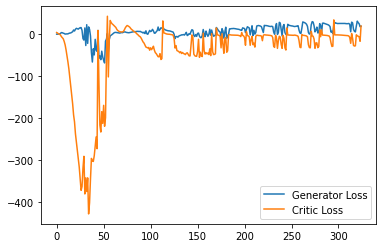

Step 6550: Generator loss: 27.904334030151368, critic loss: -1.9986971168518068


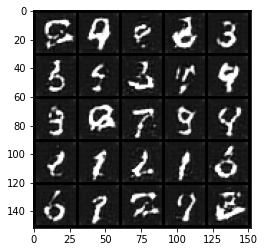

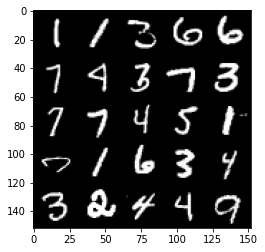

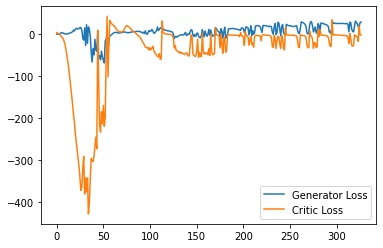

Step 6600: Generator loss: 26.72835048675537, critic loss: -2.0122681422233577


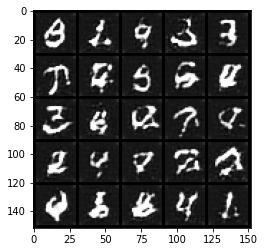

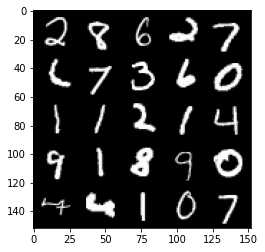

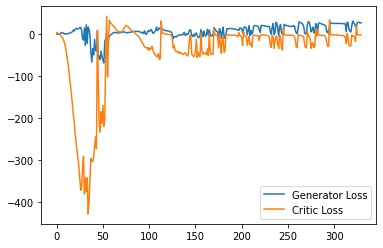

Step 6650: Generator loss: 23.663666229248047, critic loss: -1.6236849625110628


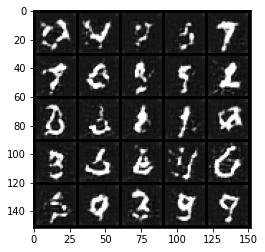

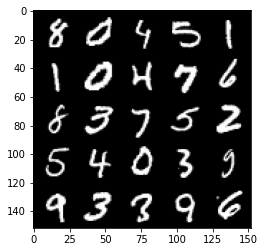

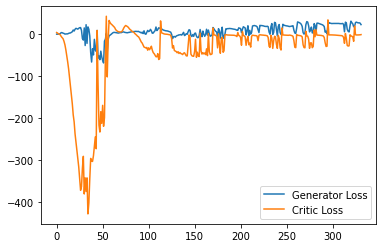

Step 6700: Generator loss: 22.413590507507323, critic loss: -2.299806178569794


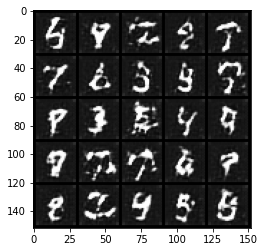

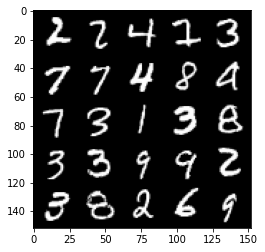

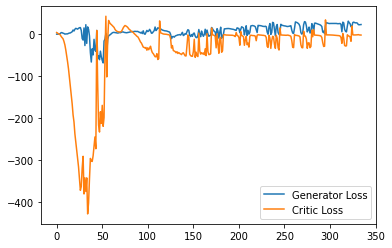

Step 6750: Generator loss: 22.95006420135498, critic loss: -2.5739668073654176


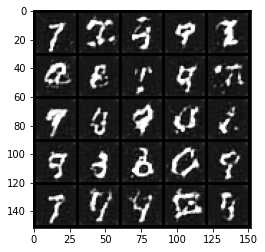

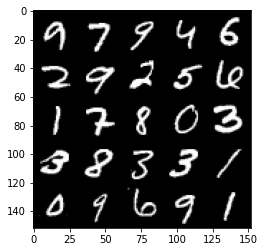

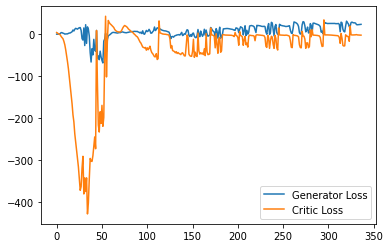

Step 6800: Generator loss: 23.01111629486084, critic loss: -3.0756300382614143


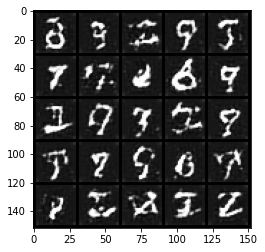

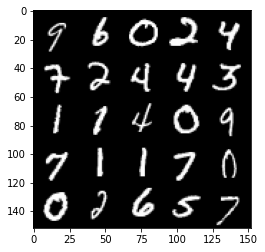

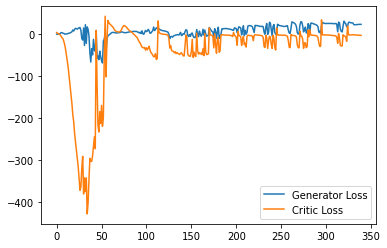

Step 6850: Generator loss: 23.276158027648925, critic loss: -3.7324331979751584


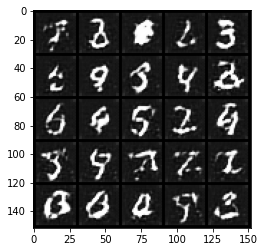

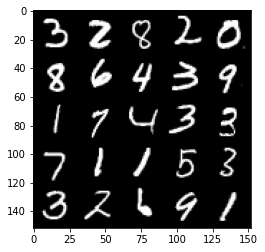

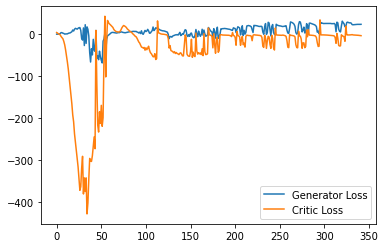

Step 6900: Generator loss: 16.609189530313014, critic loss: -5.3094881038665775


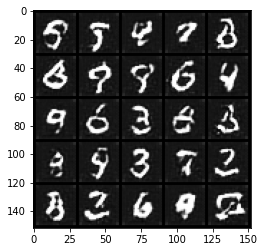

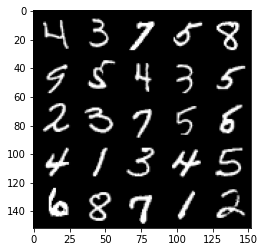

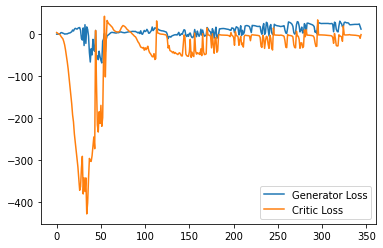

Step 6950: Generator loss: 28.698840141296387, critic loss: -2.4783662991523743


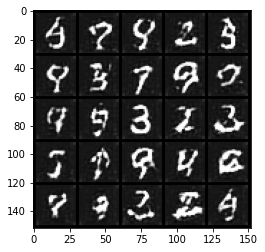

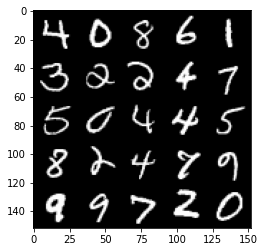

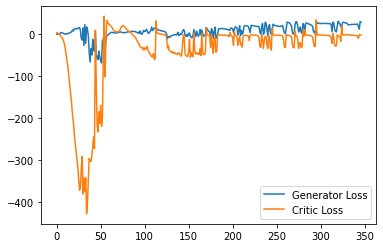

Step 7000: Generator loss: 27.942668800354003, critic loss: -2.8335642166137696


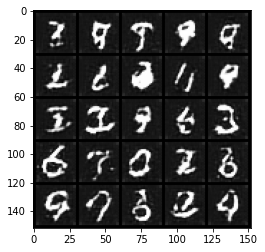

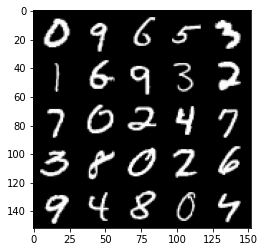

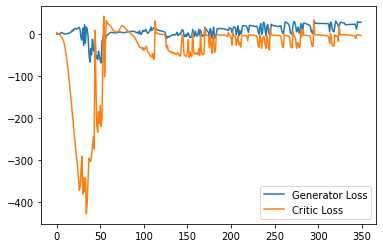

Step 7050: Generator loss: 26.817128143310548, critic loss: -3.7911075696945193


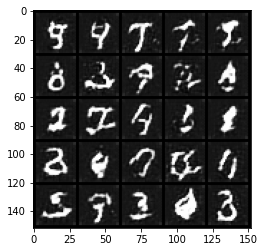

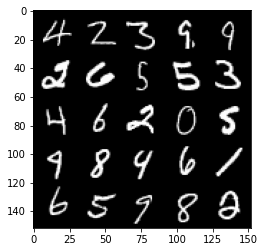

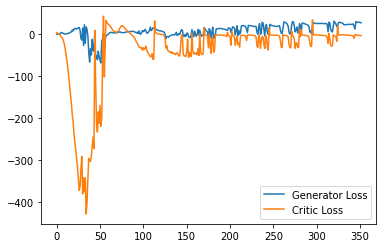

Step 7100: Generator loss: 17.21277732372284, critic loss: -10.497802523612975


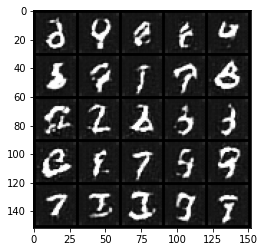

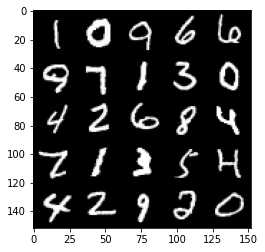

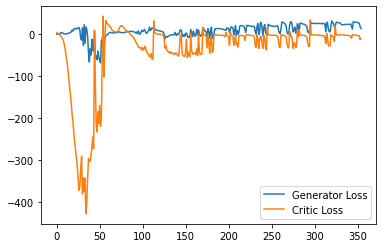

Step 7150: Generator loss: 29.737355690002442, critic loss: -3.085158404350281


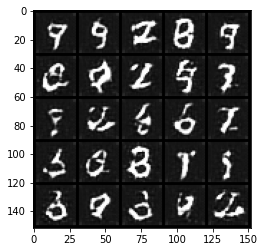

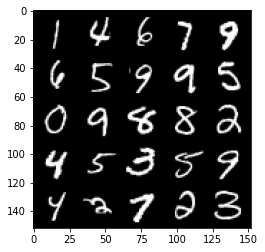

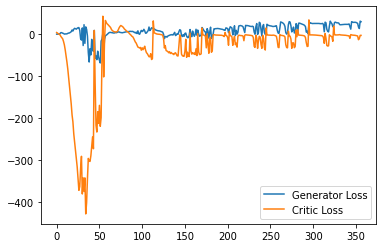

Step 7200: Generator loss: 27.20475803375244, critic loss: -3.60972218132019


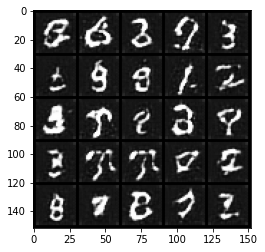

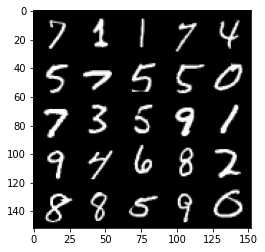

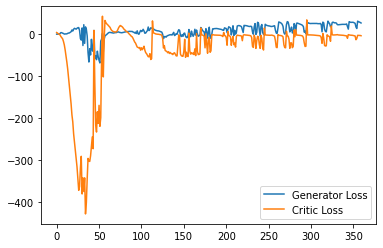

Step 7250: Generator loss: 12.008804337382317, critic loss: -13.624470426559446


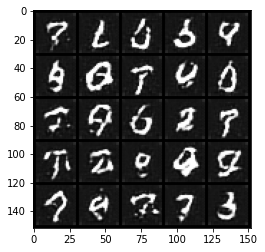

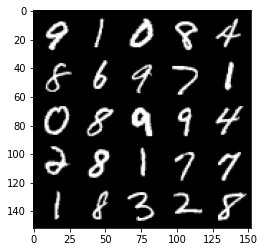

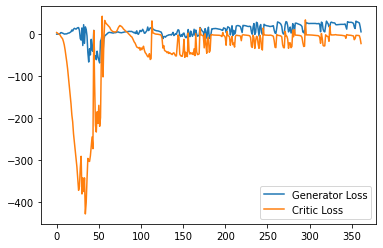

Step 7300: Generator loss: 22.635004885196686, critic loss: -11.520987561225896


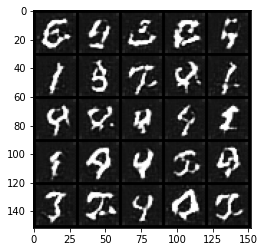

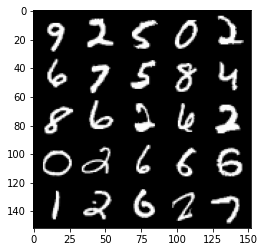

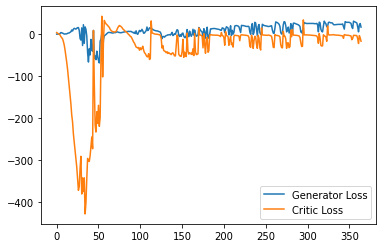

Step 7350: Generator loss: 21.32765568435192, critic loss: -19.676851426124575


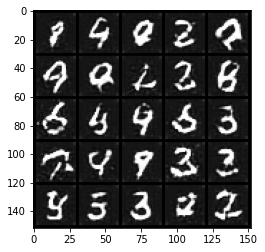

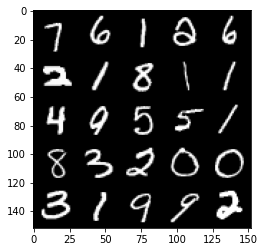

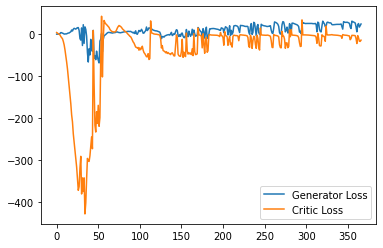

Step 7400: Generator loss: 23.881897512674332, critic loss: -1.57402600479126


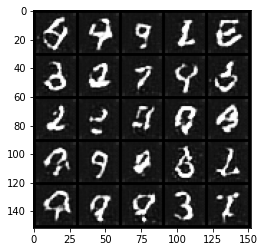

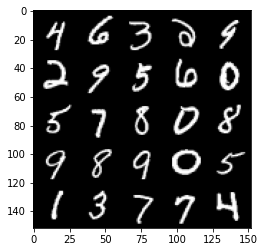

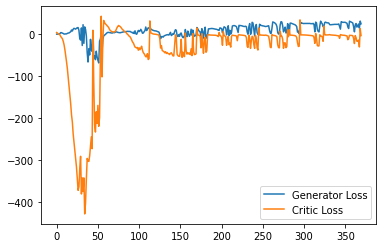

Step 7450: Generator loss: 19.952155382633208, critic loss: -12.52639509868622


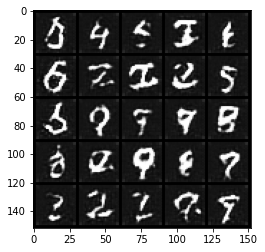

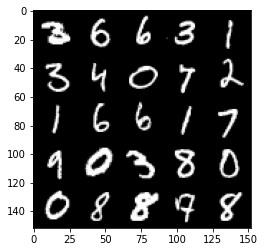

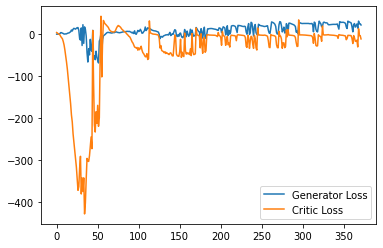

Step 7500: Generator loss: 13.794642122387886, critic loss: -20.440212606430055


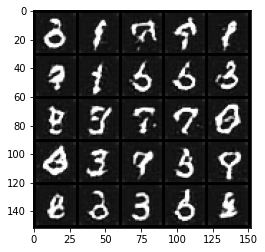

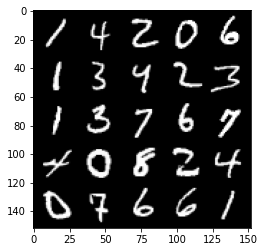

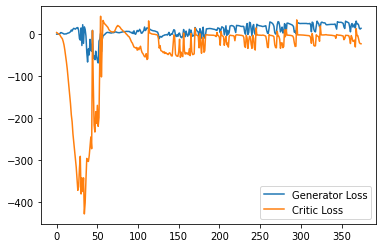

Step 7550: Generator loss: 23.550159110426904, critic loss: -3.4596880822181713


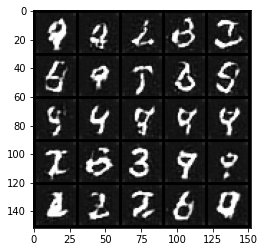

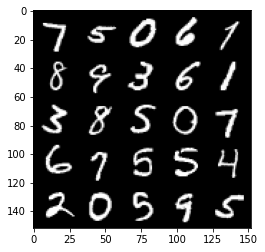

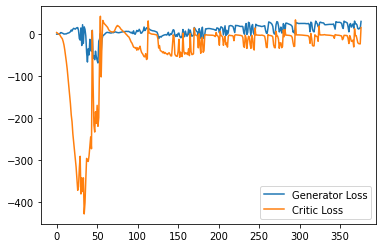

Step 7600: Generator loss: 27.761080055236818, critic loss: -3.5781856918334944


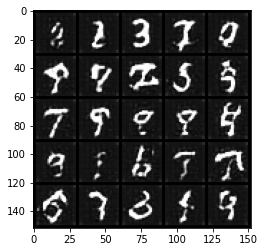

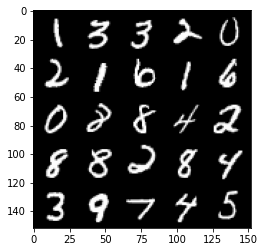

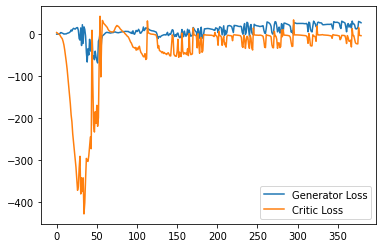

Step 7650: Generator loss: 19.802801801264287, critic loss: -10.154990556716918


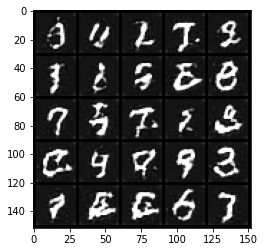

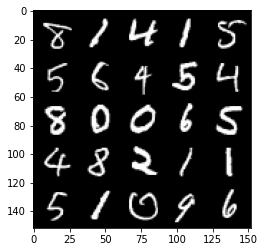

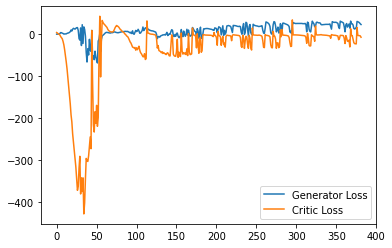

Step 7700: Generator loss: 18.23153336942196, critic loss: -12.507672341346742


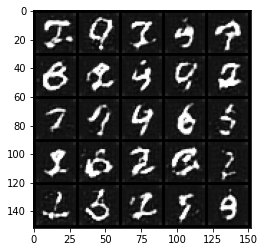

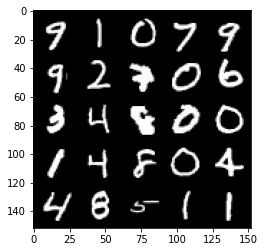

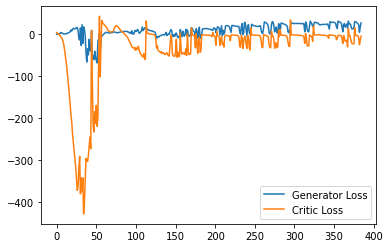

Step 7750: Generator loss: 19.428538339287044, critic loss: -1.431180939197543


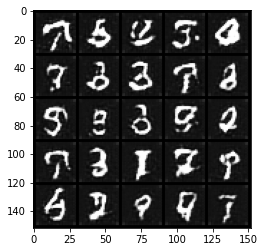

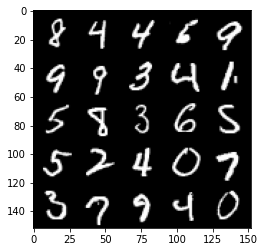

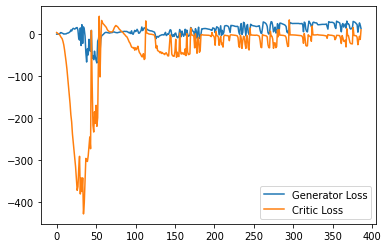

Step 7800: Generator loss: 27.704870414733886, critic loss: -2.2440892615318297


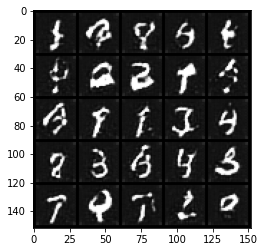

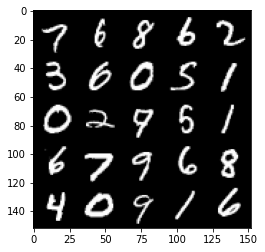

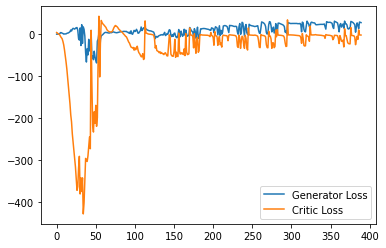

Step 7850: Generator loss: 26.38621837615967, critic loss: -2.4483365087509155


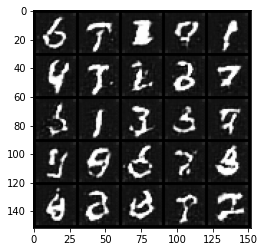

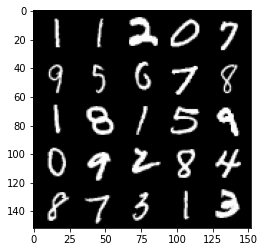

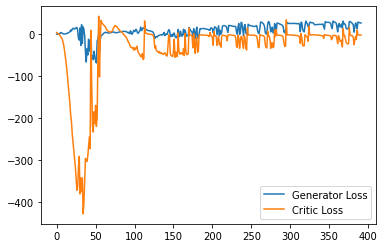

Step 7900: Generator loss: 25.641785278320313, critic loss: -2.7884255933761595


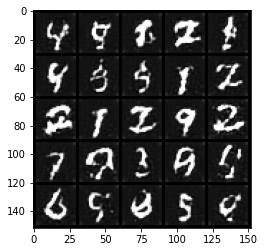

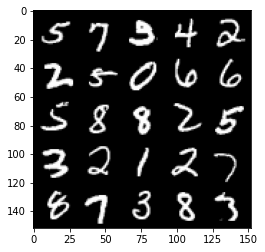

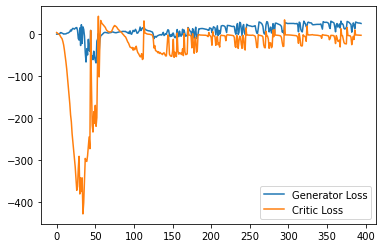

Step 7950: Generator loss: 24.720376892089845, critic loss: -3.1376653404235832


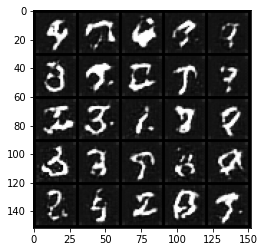

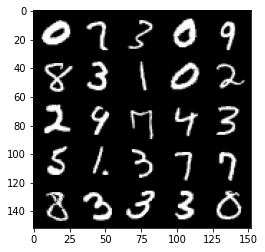

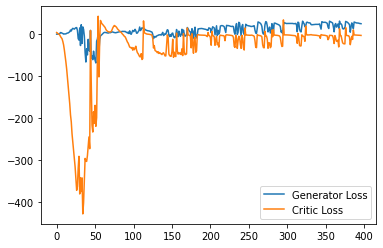

Step 8000: Generator loss: 22.09722396850586, critic loss: -4.780005795478821


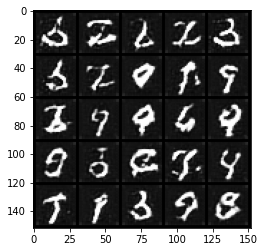

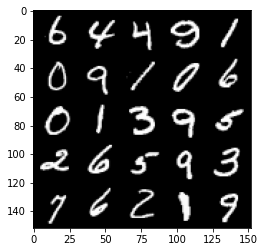

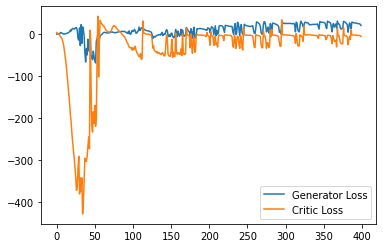

Step 8050: Generator loss: 8.762020845413208, critic loss: -21.183560804367065


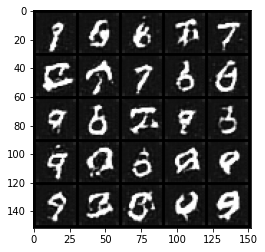

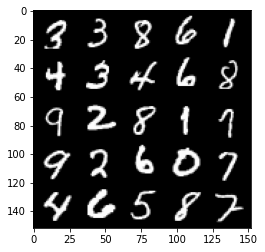

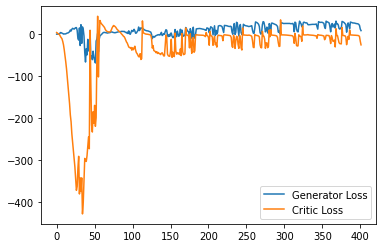

Step 8100: Generator loss: 24.124686092734336, critic loss: -4.263795351505279


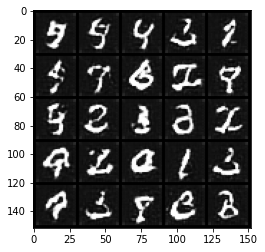

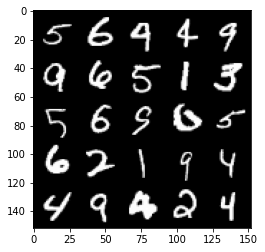

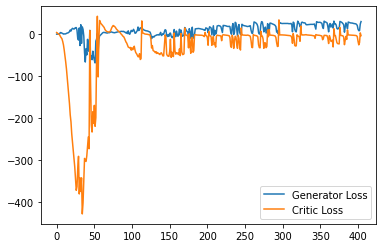

Step 8150: Generator loss: 22.932067901939153, critic loss: -7.8075741167068475


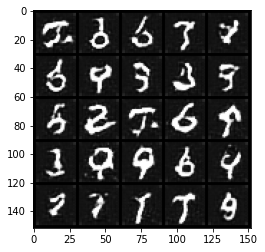

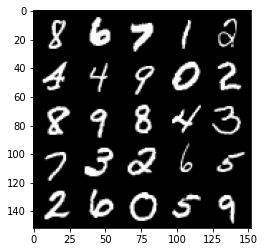

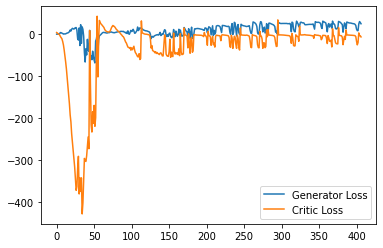

Step 8200: Generator loss: 26.910731489658357, critic loss: 3.9497789087295523


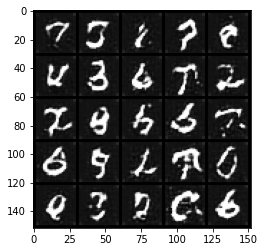

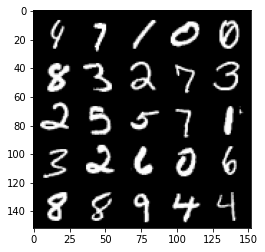

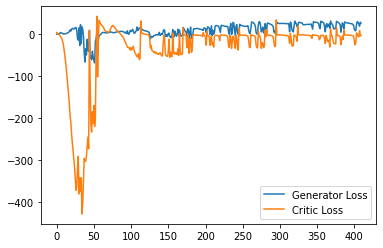

Step 8250: Generator loss: 16.18939928099513, critic loss: -12.808445300579073


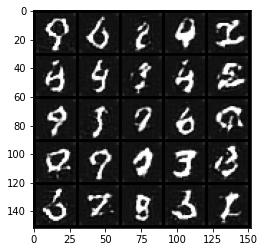

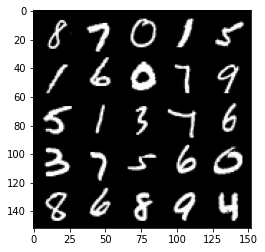

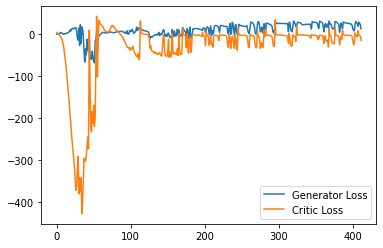

Step 8300: Generator loss: 20.59094946026802, critic loss: -12.613145675659178


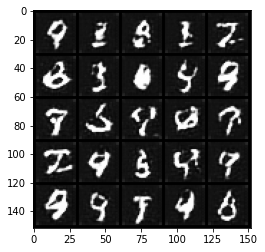

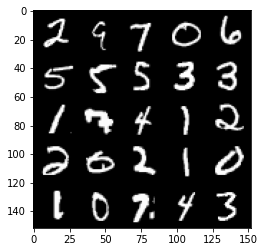

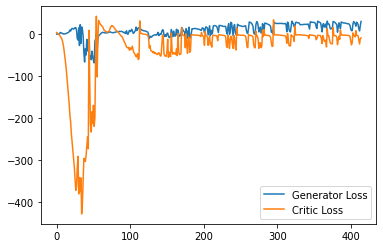

Step 8350: Generator loss: 21.604569003582, critic loss: -10.832432137489326


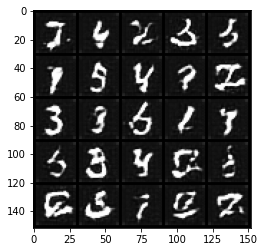

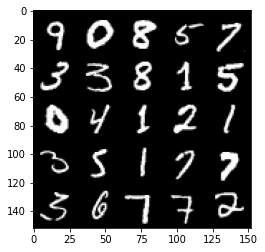

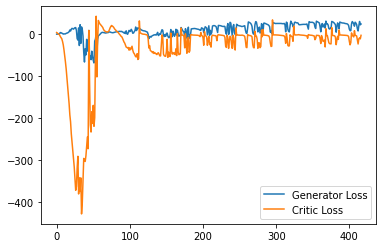

Step 8400: Generator loss: 9.469976136684418, critic loss: -24.52468954753876


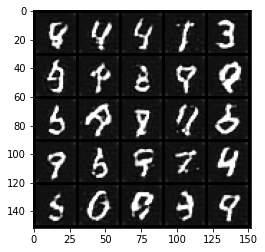

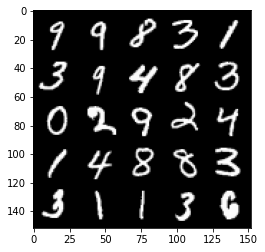

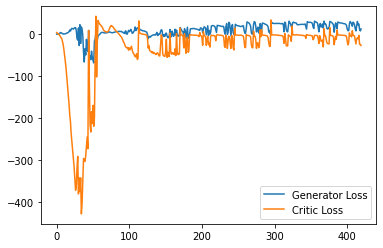

Step 8450: Generator loss: 25.312857761383057, critic loss: 2.0437233123779293


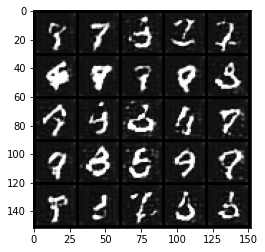

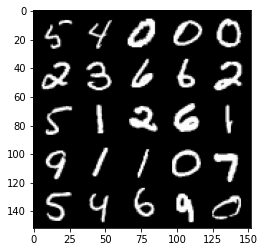

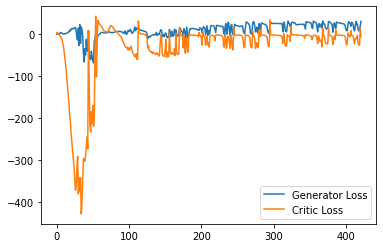

Step 8500: Generator loss: 16.76839821755886, critic loss: -8.356566509246825


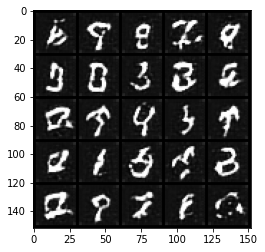

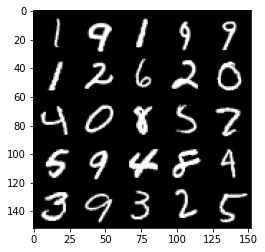

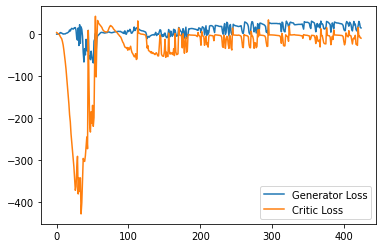

Step 8550: Generator loss: 13.594091509580613, critic loss: -9.943913527488707


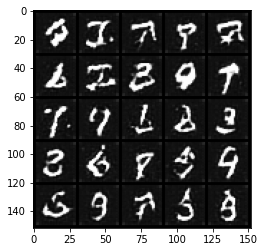

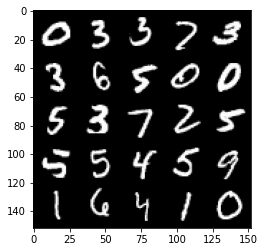

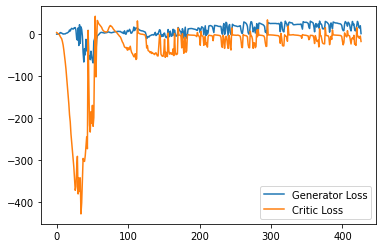

Step 8600: Generator loss: 13.203653431832791, critic loss: -15.380798926353453


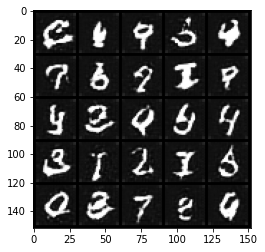

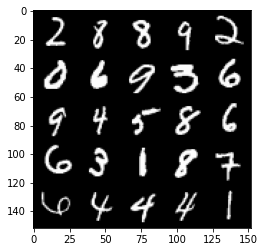

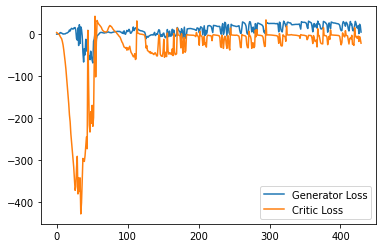

Step 8650: Generator loss: 14.05178902477026, critic loss: -5.019262548446653


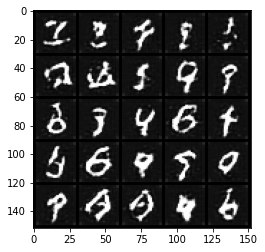

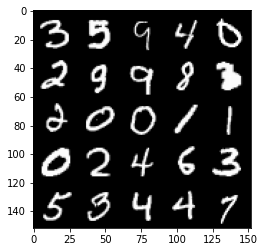

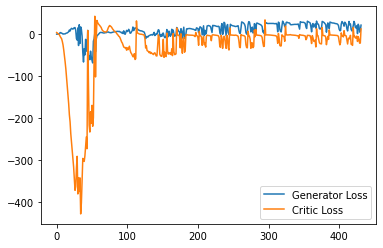

Step 8700: Generator loss: 19.078157541155814, critic loss: -9.283940227508545


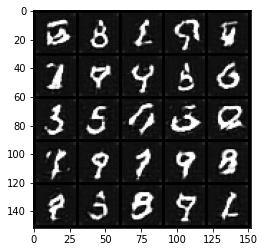

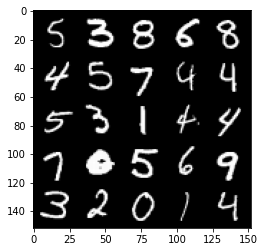

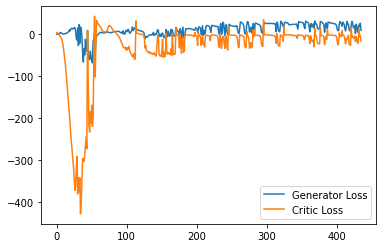

Step 8750: Generator loss: 13.808667964339257, critic loss: -16.9766387386322


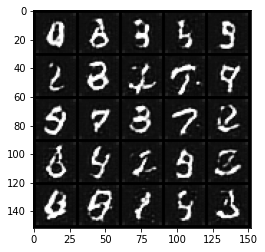

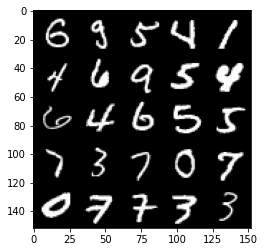

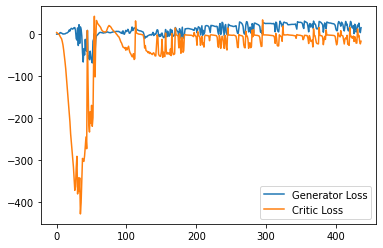

Step 8800: Generator loss: 21.85794824361801, critic loss: -7.159687057495116


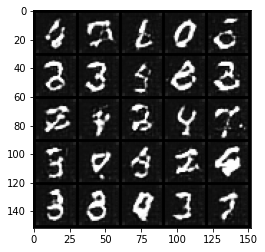

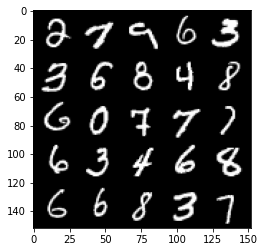

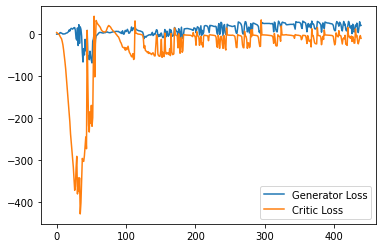

Step 8850: Generator loss: 21.84387211561203, critic loss: -4.157899998664857


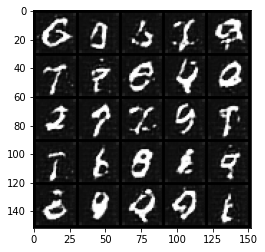

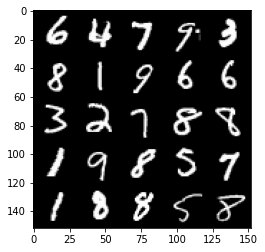

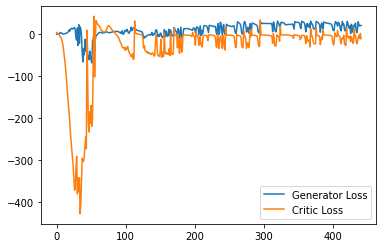

Step 8900: Generator loss: 13.562462422549725, critic loss: -16.854872607231137


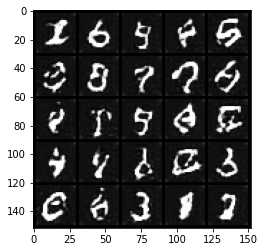

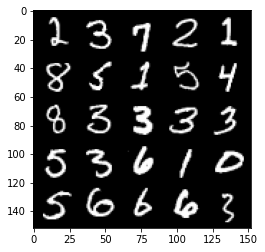

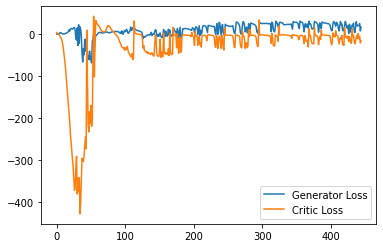

Step 8950: Generator loss: 12.730985242128373, critic loss: -19.018480697631833


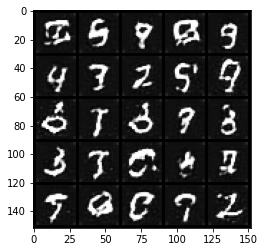

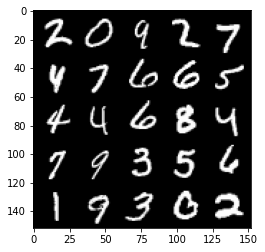

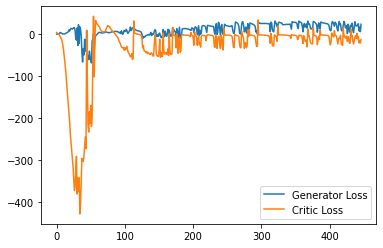

Step 9000: Generator loss: 18.568124377727507, critic loss: -4.122561551094055


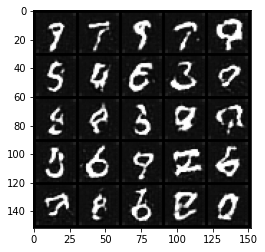

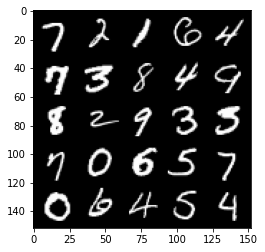

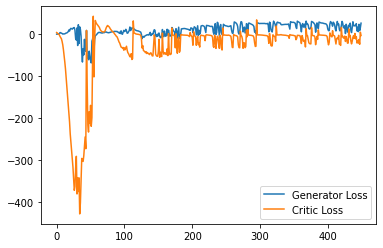

Step 9050: Generator loss: 24.25918619155884, critic loss: -6.065591982841493


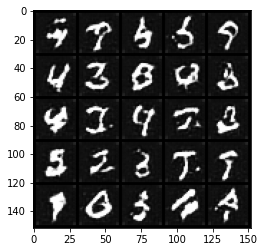

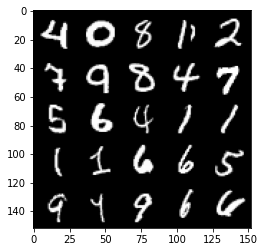

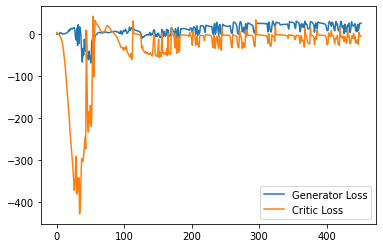

Step 9100: Generator loss: 7.2698390316963195, critic loss: -22.762087746620182


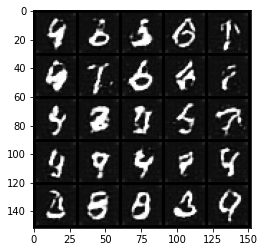

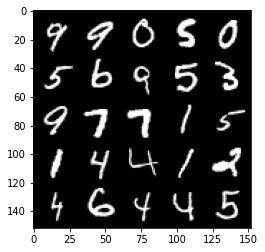

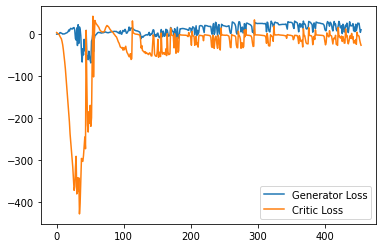

Step 9150: Generator loss: 13.417405117750167, critic loss: -18.715381497383113


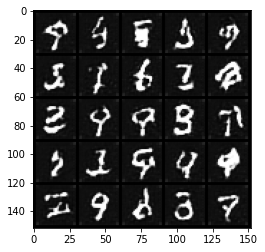

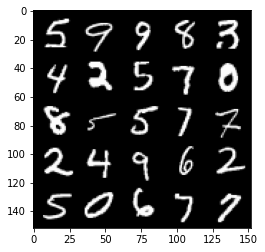

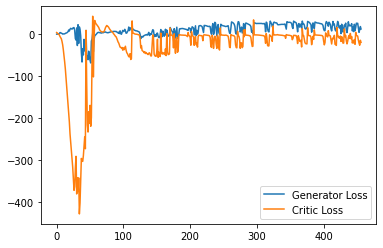

Step 9200: Generator loss: 21.70230632543564, critic loss: 6.396631215095518


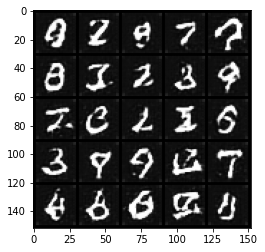

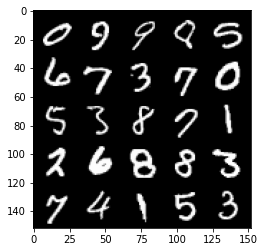

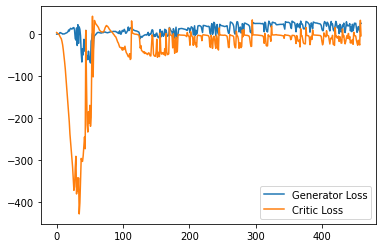

Step 9250: Generator loss: 15.942231724262237, critic loss: -9.05515625524521


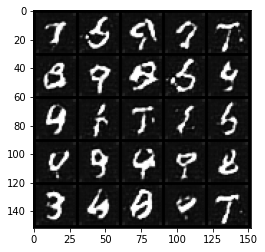

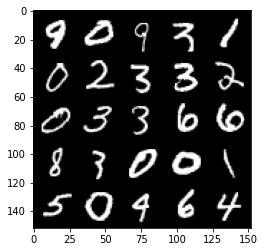

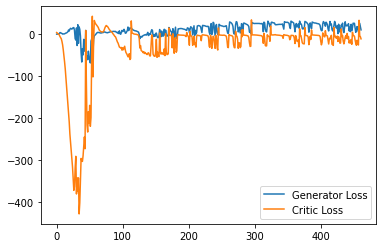

Step 9300: Generator loss: 16.427959511578084, critic loss: -14.759621751785275


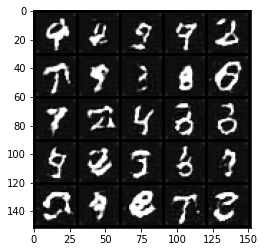

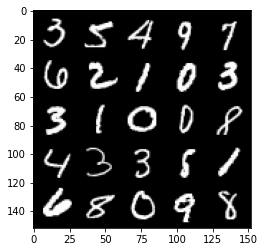

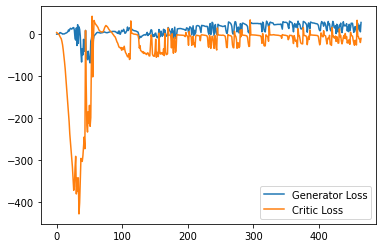

Step 9350: Generator loss: 17.375694191455842, critic loss: -12.500812801361086


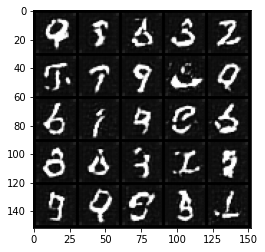

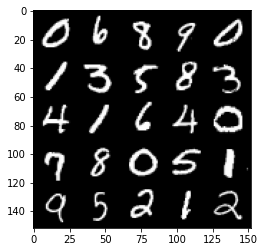

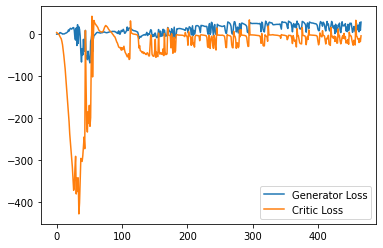

Step 9400: Generator loss: 18.035622086524963, critic loss: -15.555444178581235


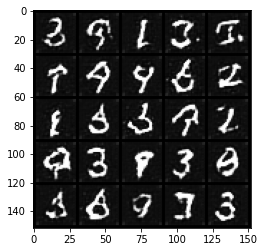

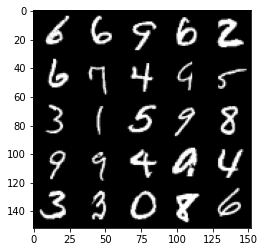

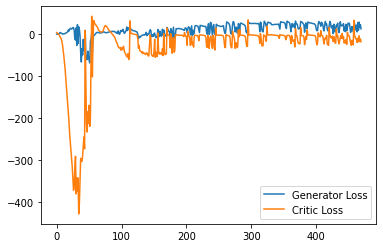

Step 9450: Generator loss: 12.20885237455368, critic loss: -18.732952620506286


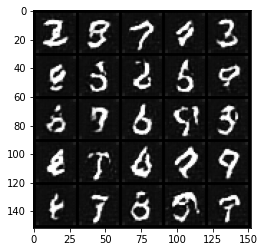

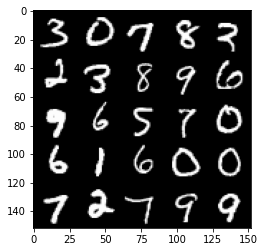

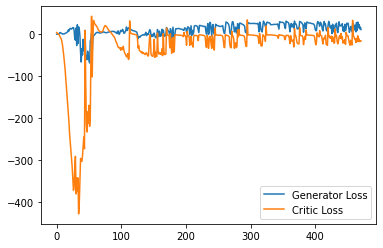

Step 9500: Generator loss: 19.4196309030056, critic loss: -2.7008958520889284


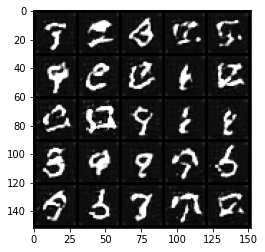

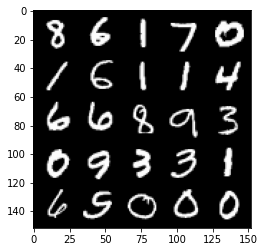

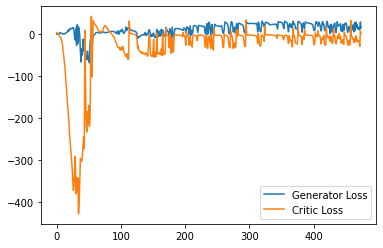

Step 9550: Generator loss: 10.875235490053893, critic loss: -13.357139189243314


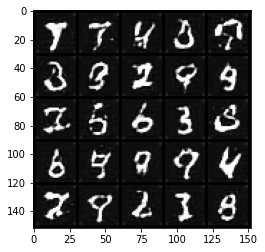

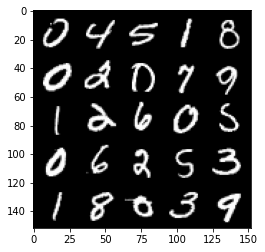

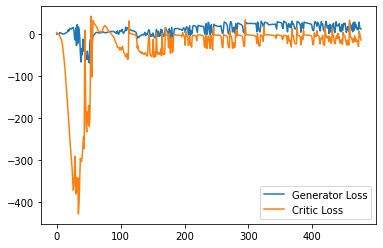

Step 9600: Generator loss: 16.833705458641052, critic loss: -8.973952573776247


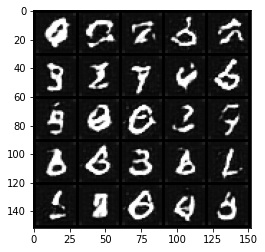

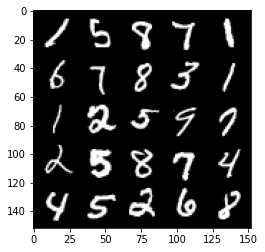

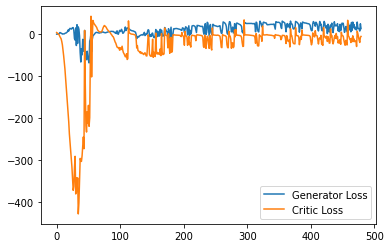

Step 9650: Generator loss: 14.46323540329933, critic loss: -9.439293477535248


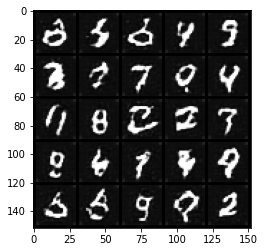

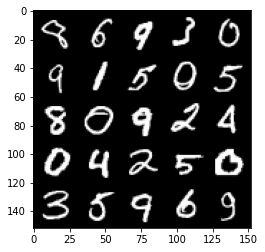

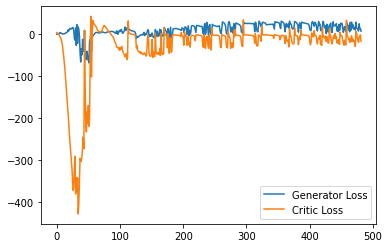

Step 9700: Generator loss: 16.404148322343826, critic loss: -14.005437033653257


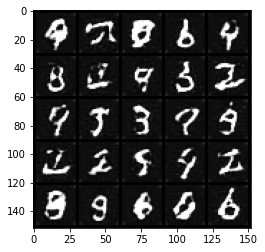

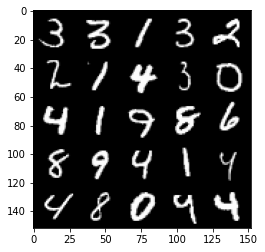

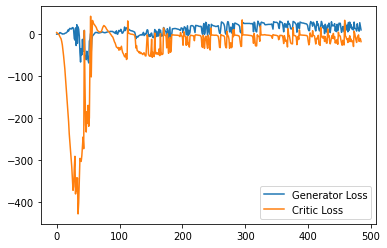

Step 9750: Generator loss: 15.483867766857147, critic loss: -16.117623691558837


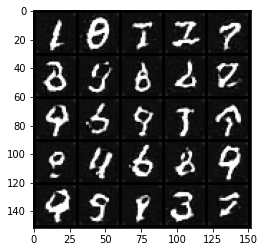

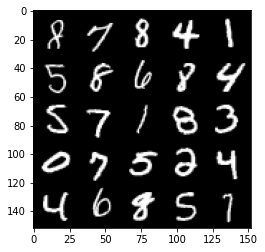

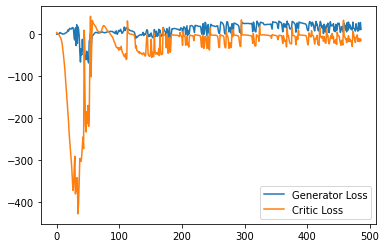

Step 9800: Generator loss: 14.013856476545334, critic loss: -14.96510800504685


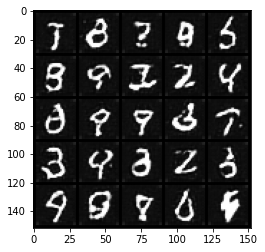

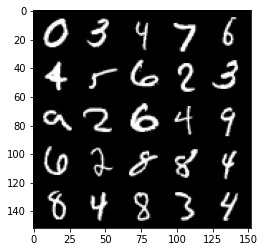

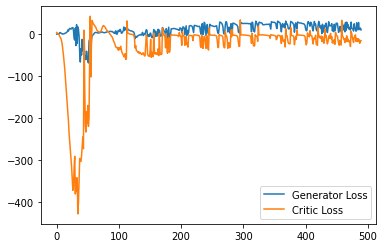

Step 9850: Generator loss: 21.916604652404786, critic loss: 10.115762731552124


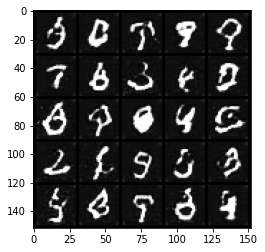

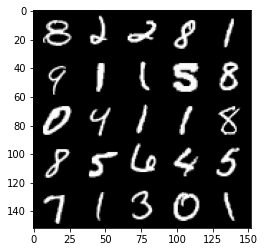

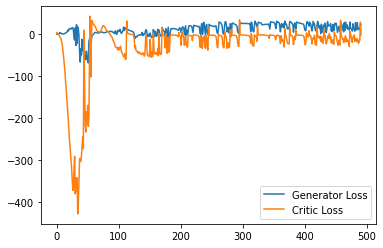

Step 9900: Generator loss: 21.051486892700197, critic loss: -1.9258040575981143


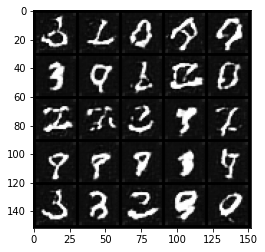

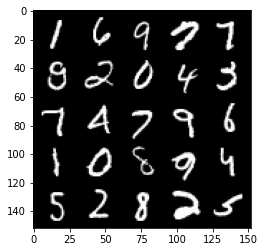

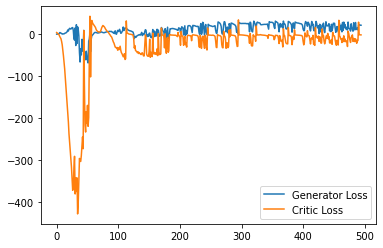

Step 9950: Generator loss: 20.87290283203125, critic loss: -2.22534388589859


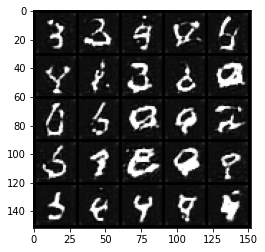

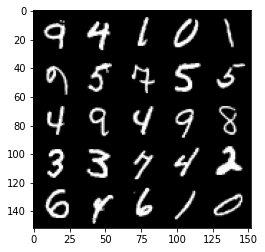

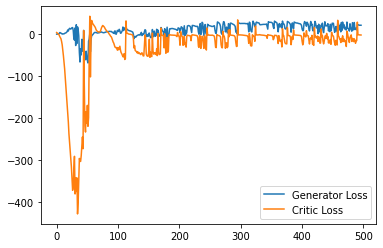

Step 10000: Generator loss: 19.928477058410646, critic loss: -2.6112074089050292


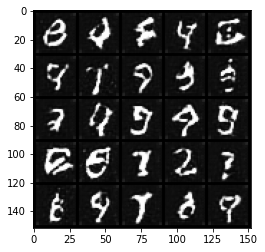

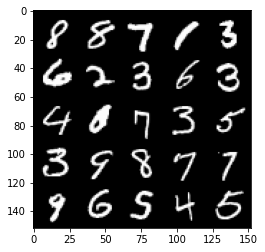

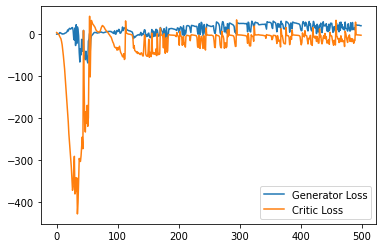

Step 10050: Generator loss: 19.508637504577635, critic loss: -3.098253944396973


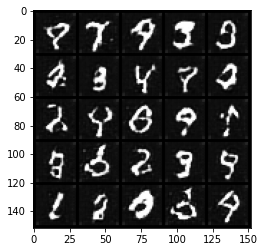

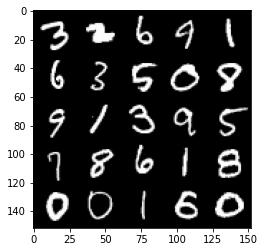

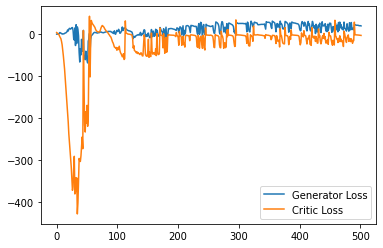

KeyboardInterrupt: ignored

In [ ]:
import matplotlib.pyplot as plt

cur_step = 0
generator_losses = []
critic_losses = []
for epoch in range(n_epochs):
    # Dataloader returns the batches
    for real, _ in tqdm(dataloader):
        cur_batch_size = len(real)
        real = real.to(device)

        mean_iteration_critic_loss = 0
        for _ in range(crit_repeats):
            ### Update critic ###
            crit_opt.zero_grad()
            fake_noise = get_noise(cur_batch_size, z_dim, device=device)
            fake = gen(fake_noise)
            crit_fake_pred = crit(fake.detach())
            crit_real_pred = crit(real)

            epsilon = torch.rand(len(real), 1, 1, 1, device=device, requires_grad=True)
            gradient = get_gradient(crit, real, fake.detach(), epsilon)
            gp = gradient_penalty(gradient)
            crit_loss = get_crit_loss(crit_fake_pred, crit_real_pred, gp, c_lambda)

            # Keep track of the average critic loss in this batch
            mean_iteration_critic_loss += crit_loss.item() / crit_repeats
            # Update gradients
            crit_loss.backward(retain_graph=True)
            # Update optimizer
            crit_opt.step()
        critic_losses += [mean_iteration_critic_loss]

        ### Update generator ###
        gen_opt.zero_grad()
        fake_noise_2 = get_noise(cur_batch_size, z_dim, device=device)
        fake_2 = gen(fake_noise_2)
        crit_fake_pred = crit(fake_2)
        
        gen_loss = get_gen_loss(crit_fake_pred)
        gen_loss.backward()

        # Update the weights
        gen_opt.step()

        # Keep track of the average generator loss
        generator_losses += [gen_loss.item()]

        ### Visualization code ###
        if cur_step % display_step == 0 and cur_step > 0:
            gen_mean = sum(generator_losses[-display_step:]) / display_step
            crit_mean = sum(critic_losses[-display_step:]) / display_step
            print(f"Step {cur_step}: Generator loss: {gen_mean}, critic loss: {crit_mean}")
            show_tensor_images(fake)
            show_tensor_images(real)
            step_bins = 20
            num_examples = (len(generator_losses) // step_bins) * step_bins
            plt.plot(
                range(num_examples // step_bins), 
                torch.Tensor(generator_losses[:num_examples]).view(-1, step_bins).mean(1),
                label="Generator Loss"
            )
            plt.plot(
                range(num_examples // step_bins), 
                torch.Tensor(critic_losses[:num_examples]).view(-1, step_bins).mean(1),
                label="Critic Loss"
            )
            plt.legend()
            plt.show()

        cur_step += 1


##Inception-v3 Network
Inception-V3 is a neural network trained on ImageNet to classify objects. You may recall from the lectures that ImageNet has over 1 million images to train on. As a result, Inception-V3 does a good job detecting features and classifying images. Here, you will load Inception-V3 as inception_model.

In [ ]:
from torchvision.models import inception_v3
inception_model = inception_v3(pretrained=False)
inception_model.load_state_dict(torch.load("inception_v3_google-1a9a5a14.pth"))
inception_model.to(device)
inception_model = inception_model.eval()

##Fréchet Inception Distance
Fréchet Inception Distance (FID) was proposed as an improvement over Inception Score and still uses the Inception-v3 network as part of its calculation. However, instead of using the classification labels of the Inception-v3 network, it uses the output from an earlier layer—the layer right before the labels. This is often called the feature layer. Research has shown that deep convolutional neural networks trained on difficult tasks, like classifying many classes, build increasingly sophisticated representations of features going deeper into the network. For example, the first few layers may learn to detect different kinds of edges and curves, while the later layers may have neurons that fire in response to human faces.

To get the feature layer of a convolutional neural network, you can replace the final fully connected layer with an identity layer that simply returns whatever input it received, unchanged. This essentially removes the final classification layer and leaves you with the intermediate outputs from the layer before.

In [ ]:
# UNQ_C1 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED CELL: inception_model.fc

# You want to replace the final fully-connected (fc) layer 
# with an identity function layer to cut off the classification
# layer and get a feature extractor
#### START CODE HERE ####
inception_model.fc = torch.nn.Identity()

###Fréchet Distance
Fréchet distance uses the values from the feature layer for two sets of images, say reals and fakes, and compares different statistical properties between them to see how different they are. Specifically, Fréchet distance finds the shortest distance needed to walk along two lines, or two curves, simultaneously. The most intuitive explanation of Fréchet distance is as the "minimum leash distance" between two points. Imagine yourself and your dog, both moving along two curves. If you walked on one curve and your dog, attached to a leash, walked on the other at the same pace, what is the least amount of leash that you can give your dog so that you never need to give them more slack during your walk? Using this, the Fréchet distance measures the similarity between these two curves.

The basic idea is similar for calculating the Fréchet distance between two probability distributions. You'll start by seeing what this looks like in one-dimensional, also called univariate, space.

####Univariate Fréchet Distance
You can calculate the distance between two normal distributions 𝑋 and 𝑌 with means 𝜇𝑋 and 𝜇𝑌 and standard deviations 𝜎𝑋 and 𝜎𝑌, as:

𝑑(𝑋,𝑌)=(𝜇𝑋−𝜇𝑌)2+(𝜎𝑋−𝜎𝑌)2

Pretty simple, right? Now you can see how it can be converted to be used in multi-dimensional, which is also called multivariate, space.

####Multivariate Fréchet Distance
####Covariance

To find the Fréchet distance between two multivariate normal distributions, you first need to find the covariance instead of the standard deviation. The covariance, which is the multivariate version of variance (the square of standard deviation), is represented using a square matrix where the side length is equal to the number of dimensions. Since the feature vectors you will be using have 2048 values/weights, the covariance matrix will be 2048 x 2048. But for the sake of an example, this is a covariance matrix in a two-dimensional space:

Σ= (1 0

   0 1)

The value at location (𝑖,𝑗) corresponds to the covariance of vector 𝑖 with vector 𝑗. Since the covariance of 𝑖 with 𝑗 and 𝑗 with 𝑖 are equivalent, the matrix will always be symmetric with respect to the diagonal. The diagonal is the covariance of that element with itself. In this example, there are zeros everywhere except the diagonal. That means that the two dimensions are independent of one another, they are completely unrelated.

/usr/local/lib/python3.6/dist-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


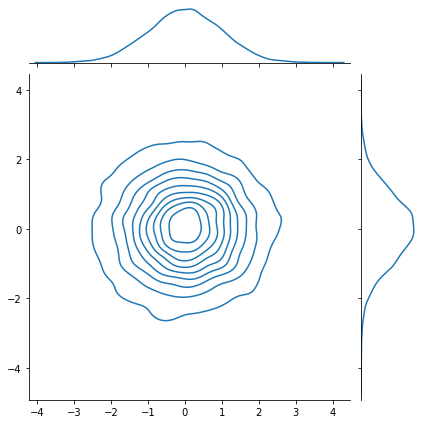

In [ ]:
#import os
#os.environ['KMP_DUPLICATE_LIB_OK']='True'

from torch.distributions import MultivariateNormal
import seaborn as sns # This is for visualization
mean = torch.Tensor([0, 0]) # Center the mean at the origin
covariance = torch.Tensor( # This matrix shows independence - there are only non-zero values on the diagonal
    [[1, 0],
     [0, 1]]
)
independent_dist = MultivariateNormal(mean, covariance)
samples = independent_dist.sample((10000,))
res = sns.jointplot(samples[:, 0], samples[:, 1], kind="kde")
plt.show()

Now, here's an example of a multivariate normal distribution that has covariance:

Σ= (2 −1

   −1  2) 

And see how it looks:

/usr/local/lib/python3.6/dist-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


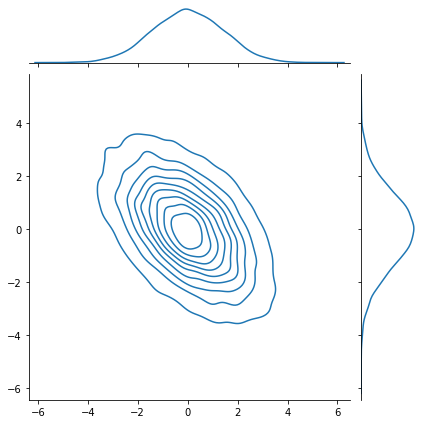

In [ ]:
mean = torch.Tensor([0, 0])
covariance = torch.Tensor(
    [[2, -1],
     [-1, 2]]
)
covariant_dist = MultivariateNormal(mean, covariance)
samples = covariant_dist.sample((10000,))
res = sns.jointplot(samples[:, 0], samples[:, 1], kind="kde")
plt.show()

####Formula

Based on the paper, "The Fréchet distance between multivariate normal distributions" by Dowson and Landau (1982), the Fréchet distance between two multivariate normal distributions  𝑋  and  𝑌  is:

𝑑(𝑋,𝑌)=‖𝜇𝑋−𝜇𝑌‖2+Tr(Σ𝑋+Σ𝑌−2√Σ𝑋Σ𝑌) 

Similar to the formula for univariate Fréchet distance, you can calculate the distance between the means and the distance between the standard deviations. However, calculating the distance between the standard deviations changes slightly here, as it includes the matrix product and matrix square root.  Tr  refers to the trace, the sum of the diagonal elements of a matrix.

Now you can implement this!

In [ ]:
import scipy
# This is the matrix square root function you will be using
def matrix_sqrt(x):
    '''
    Function that takes in a matrix and returns the square root of that matrix.
    For an input matrix A, the output matrix B would be such that B @ B is the matrix A.
    Parameters:
        x: a matrix
    '''
    y = x.cpu().detach().numpy()
    y = scipy.linalg.sqrtm(y)
    return torch.Tensor(y.real, device=x.device)

In [ ]:
# UNQ_C2 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: frechet_distance
def frechet_distance(mu_x, mu_y, sigma_x, sigma_y):
    '''
    Function for returning the Fréchet distance between multivariate Gaussians,
    parameterized by their means and covariance matrices.
    Parameters:
        mu_x: the mean of the first Gaussian, (n_features)
        mu_y: the mean of the second Gaussian, (n_features) 
        sigma_x: the covariance matrix of the first Gaussian, (n_features, n_features)
        sigma_y: the covariance matrix of the second Gaussian, (n_features, n_features)
    '''
    #### START CODE HERE ####
    #fd = (torch.norm(mu_x - mu_y))**2+ torch.trace(sigma_x) + torch.trace(sigma_y) - 2*torch.trace(matrix_sqrt(sigma_x @ sigma_y))
    fd = (torch.norm(mu_x - mu_y))**2+ torch.trace(sigma_x + sigma_y - 2*(matrix_sqrt(sigma_x @ sigma_y)))
    return fd

In [ ]:
# UNIT TEST

mean1 = torch.Tensor([0, 0]) # Center the mean at the origin
covariance1 = torch.Tensor( # This matrix shows independence - there are only non-zero values on the diagonal
    [[1, 0],
     [0, 1]]
)
dist1 = MultivariateNormal(mean1, covariance1)

mean2 = torch.Tensor([0, 0]) # Center the mean at the origin
covariance2 = torch.Tensor( # This matrix shows dependence 
    [[2, -1],
     [-1, 2]]
)
dist2 = MultivariateNormal(mean2, covariance2)

assert torch.isclose(
    frechet_distance(
        dist1.mean, dist2.mean,
        dist1.covariance_matrix, dist2.covariance_matrix
    ),
    4 - 2 * torch.sqrt(torch.tensor(3.))
)

assert (frechet_distance(
        dist1.mean, dist1.mean,
        dist1.covariance_matrix, dist1.covariance_matrix
    ).item() == 0)

print("Success!")

Success!


##Putting it all together!
Now, you can apply FID to your generator from earlier.

You will start by defining a bit of helper code to preprocess the image for the Inception-v3 network:

In [ ]:
def preprocess(img):
    img = torch.nn.functional.interpolate(img, size=(299, 299), mode='bilinear', align_corners=False)
    return img

Then, you'll define a function to calculate the covariance of the features that returns a covariance matrix given a list of values:

In [ ]:
import numpy as np
def get_covariance(features):
    return torch.Tensor(np.cov(features.detach().numpy(), rowvar=False))

Finally, you can use the pre-trained Inception-v3 model to compute features of the real and fake images. With these features, you can then get the covariance and means of these features across many samples.

First, you get the features of the real and fake images using the Inception-v3 model:

In [ ]:
fake_features_list = []
real_features_list = []

gen.eval()
n_samples = 512 # The total number of samples
batch_size = 4 # Samples per iteration

dataloader = DataLoader(
    dataset,
    batch_size=batch_size,
    shuffle=True)

cur_samples = 0
with torch.no_grad(): # You don't need to calculate gradients here, so you do this to save memory
    try:
        for real_example, _ in tqdm(dataloader, total=n_samples // batch_size): # Go by batch
            real_samples = real_example
            real_features = inception_model(real_samples.to(device)).detach().to('cpu') # Move features to CPU
            real_features_list.append(real_features)

            fake_samples = get_noise(len(real_example), z_dim).to(device)
            fake_samples = preprocess(gen(fake_samples))
            fake_features = inception_model(fake_samples.to(device)).detach().to('cpu')
            fake_features_list.append(fake_features)
            cur_samples += len(real_samples)
            if cur_samples >= n_samples:
                break
    except:
        print("Error in loop")

Then, you can combine all of the values that you collected for the reals and fakes into large tensors:



In [ ]:
# UNIT TEST COMMENT: Needed as is for autograding
fake_features_all = torch.cat(fake_features_list)
real_features_all = torch.cat(real_features_list)

And calculate the covariance and means of these real and fake features:

In [ ]:
# UNQ_C4 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED CELL

# Calculate the covariance matrix for the fake and real features
# and also calculate the means of the feature over the batch (for each feature dimension mean)
#### START CODE HERE ####
cov_real = get_covariance(real_features_all)
cov_fake = get_covariance(fake_features_all)
mean_real = torch.mean(real_features_all, dim = 1)
mean_fake = torch.mean(fake_features_all, dim = 1)

At this point, you can also visualize what the pairwise multivariate distributions of the inception features look like!

In [ ]:
indices = [2, 4, 5]
fake_dist = MultivariateNormal(mu_fake[indices], sigma_fake[indices][:, indices])
fake_samples = fake_dist.sample((5000,))
real_dist = MultivariateNormal(mu_real[indices], sigma_real[indices][:, indices])
real_samples = real_dist.sample((5000,))

import pandas as pd
df_fake = pd.DataFrame(fake_samples.numpy(), columns=indices)
df_real = pd.DataFrame(real_samples.numpy(), columns=indices)
df_fake["is_real"] = "no"
df_real["is_real"] = "yes"
df = pd.concat([df_fake, df_real])
sns.pairplot(df, plot_kws={'alpha': 0.1}, hue='is_real')

Lastly, you can use your earlier frechet_distance function to calculate the FID and evaluate your GAN. You can see how similar/different the features of the generated images are to the features of the real images. The next cell might take five minutes or so to run in Coursera.

In [ ]:
with torch.no_grad():
    print(frechet_distance(mu_real, mu_fake, sigma_real, sigma_fake).item())